# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels,n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.4173104737997053, discriminator loss: 0.23815405417233707


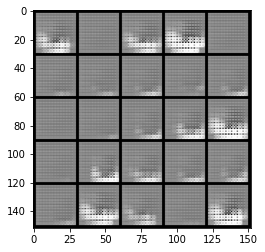

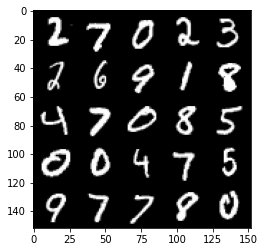

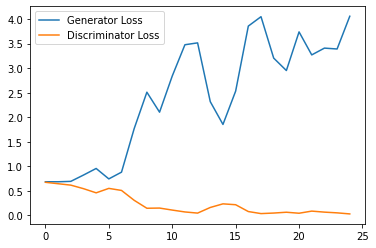

Step 1000: Generator loss: 4.417659510612488, discriminator loss: 0.039409132982604206


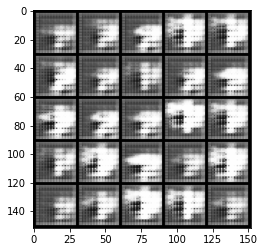

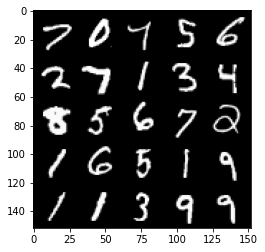

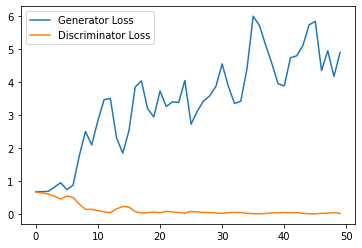

Step 1500: Generator loss: 4.379230220794677, discriminator loss: 0.062228748919442294


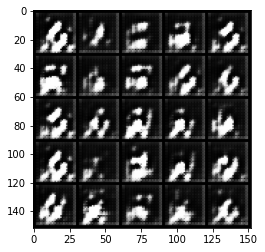

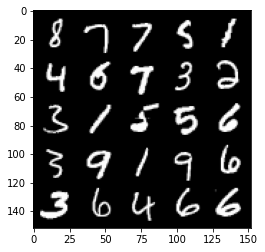

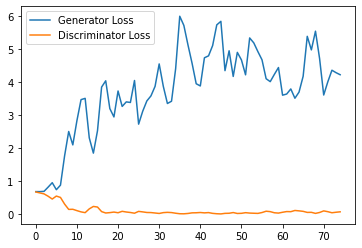

Step 2000: Generator loss: 3.454125814914703, discriminator loss: 0.11628752323240042


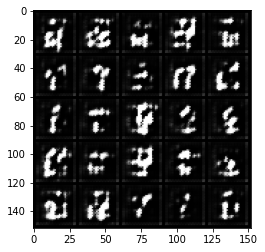

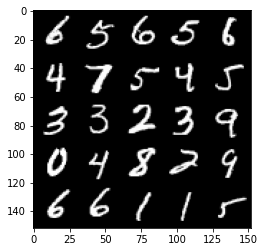

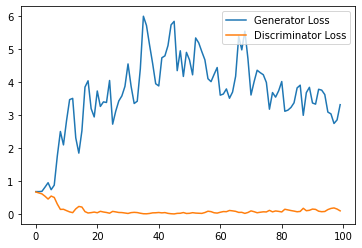

Step 2500: Generator loss: 2.913562573671341, discriminator loss: 0.17477503991127014


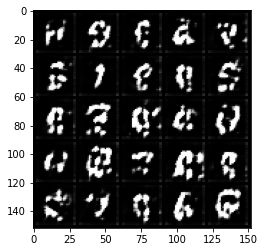

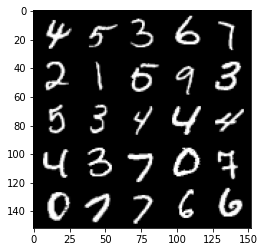

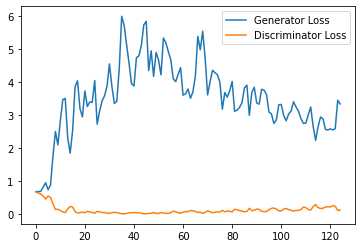

Step 3000: Generator loss: 2.5536600222587587, discriminator loss: 0.25191451862454417


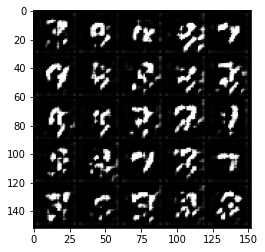

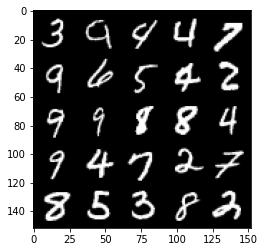

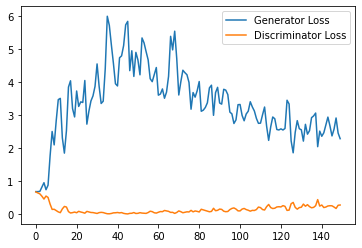

Step 3500: Generator loss: 2.4938646059036254, discriminator loss: 0.2703362217694521


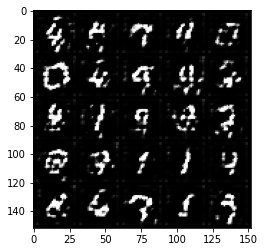

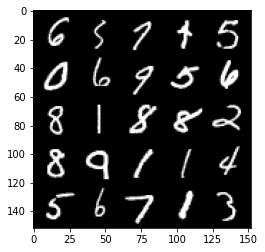

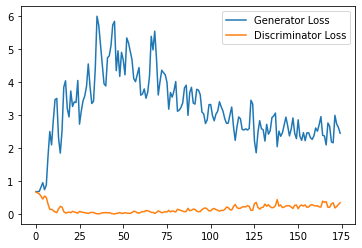

Step 4000: Generator loss: 2.2738744542598726, discriminator loss: 0.26330628740787504


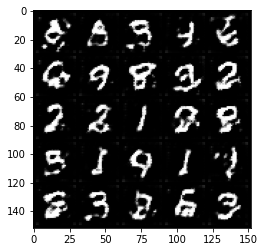

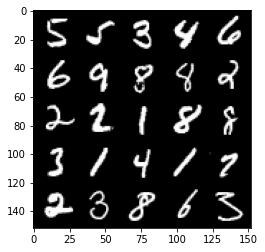

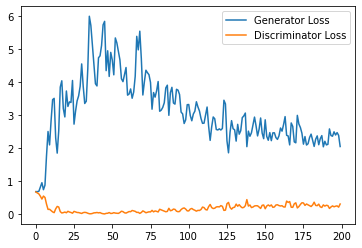

Step 4500: Generator loss: 2.214574739933014, discriminator loss: 0.30472710677981374


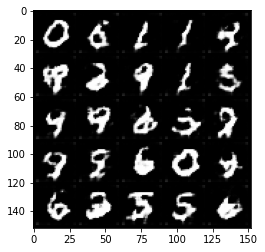

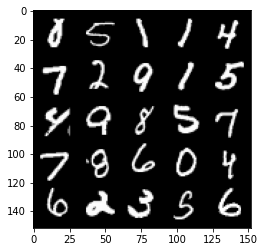

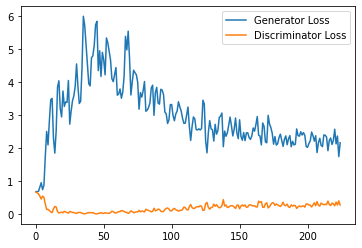

Step 5000: Generator loss: 2.0042744336128235, discriminator loss: 0.34352609488368036


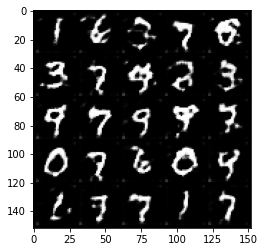

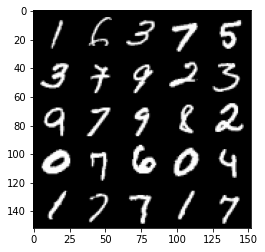

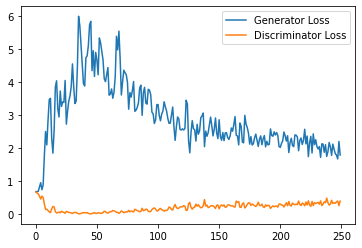

Step 5500: Generator loss: 1.8331078724861145, discriminator loss: 0.3719670049548149


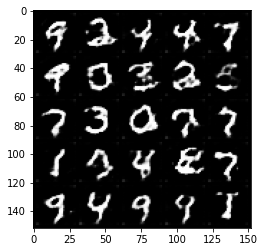

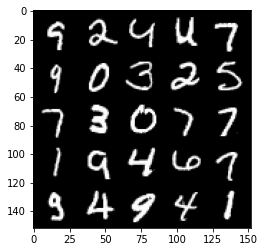

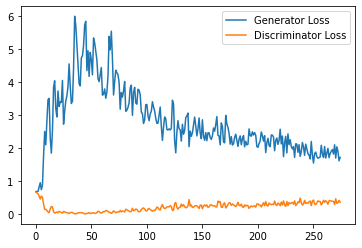

Step 6000: Generator loss: 1.6656110048294068, discriminator loss: 0.3967978117465973


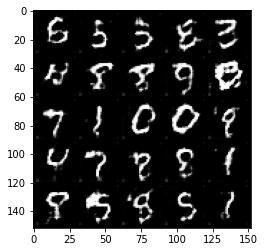

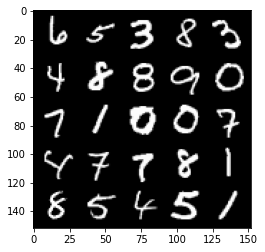

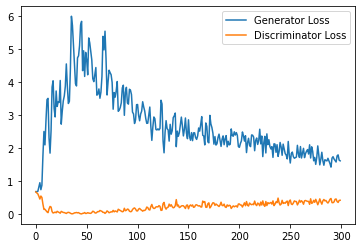

Step 6500: Generator loss: 1.646076860666275, discriminator loss: 0.42421518462896346


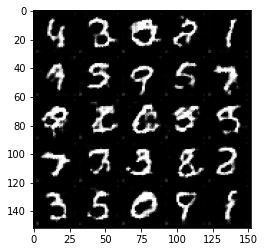

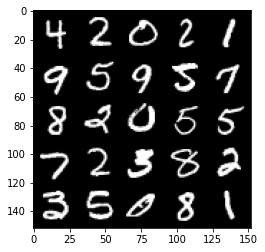

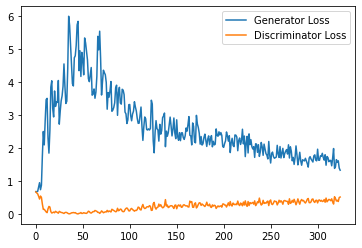

Step 7000: Generator loss: 1.5642556629180908, discriminator loss: 0.4443706701695919


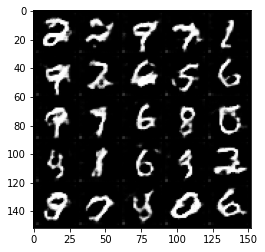

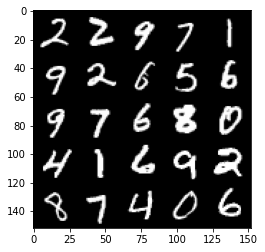

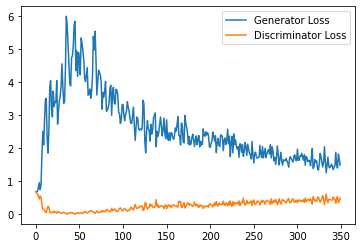

Step 7500: Generator loss: 1.4276544786691665, discriminator loss: 0.4832388639450073


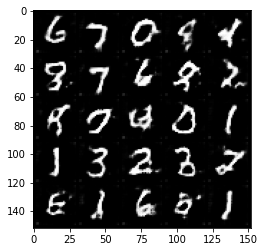

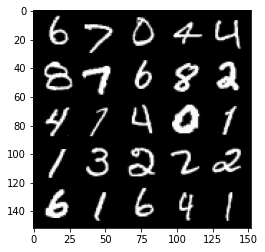

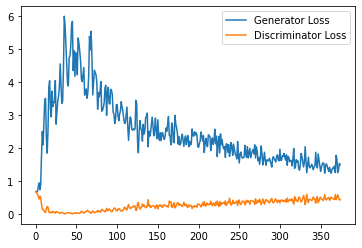

Step 8000: Generator loss: 1.406973203420639, discriminator loss: 0.5061493198871613


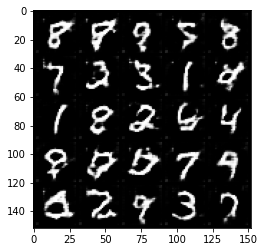

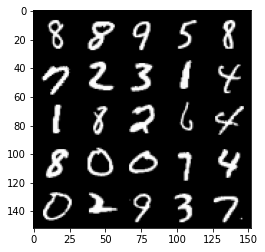

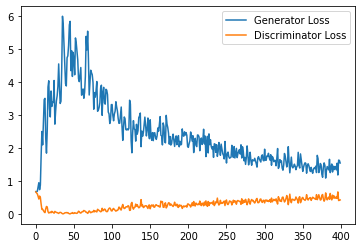

Step 8500: Generator loss: 1.3399305062294007, discriminator loss: 0.5277797702550888


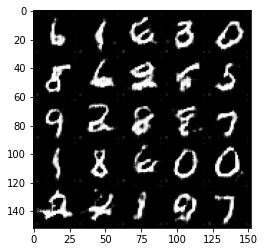

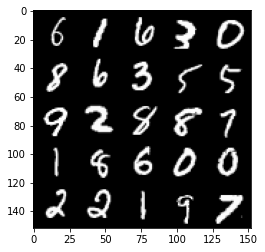

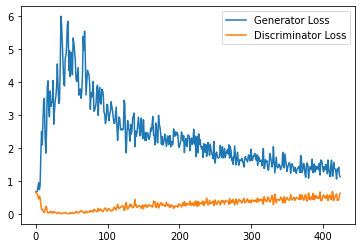

Step 9000: Generator loss: 1.2480232257843018, discriminator loss: 0.5298416010737419


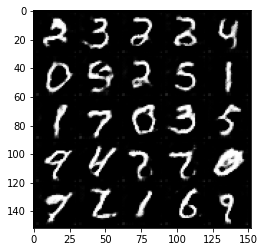

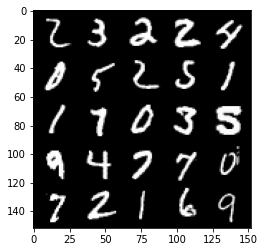

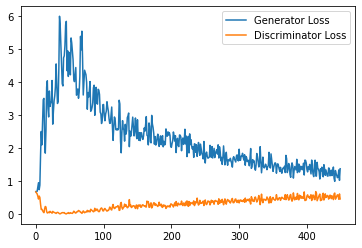

Step 9500: Generator loss: 1.304809240579605, discriminator loss: 0.547275297999382


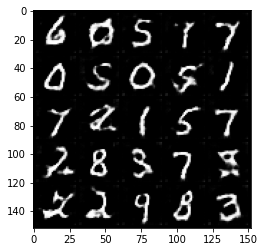

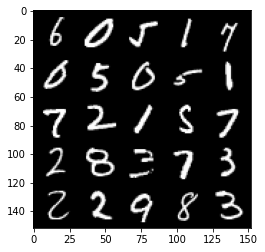

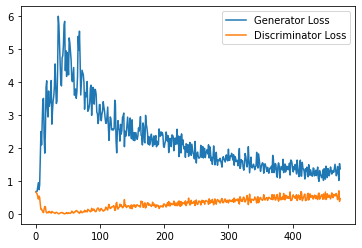

Step 10000: Generator loss: 1.2677346187829972, discriminator loss: 0.5540743728876114


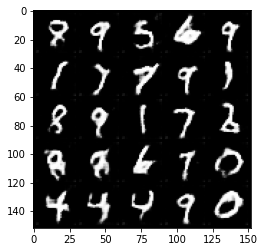

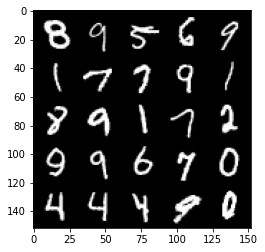

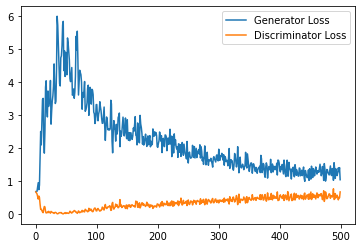

Step 10500: Generator loss: 1.2452593597173691, discriminator loss: 0.5468459342122078


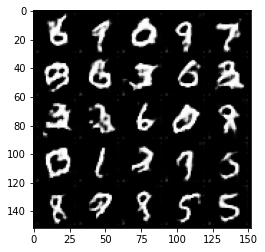

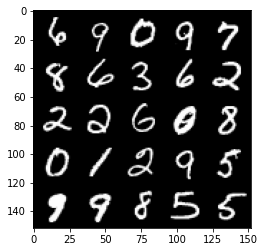

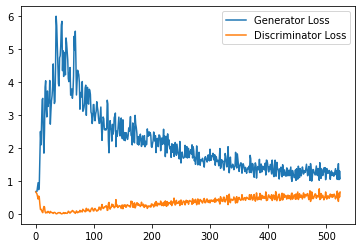

Step 11000: Generator loss: 1.2098079822063446, discriminator loss: 0.5467739504575729


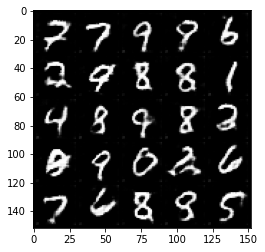

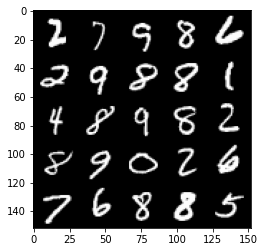

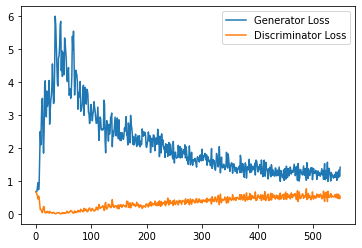

Step 11500: Generator loss: 1.1759056402444839, discriminator loss: 0.5686265052556991


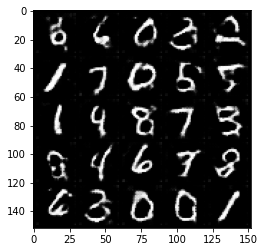

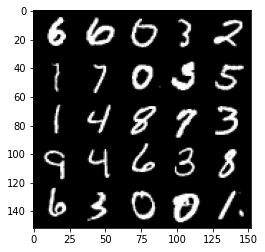

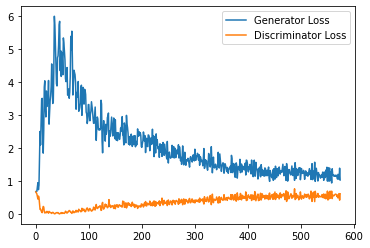

Step 12000: Generator loss: 1.177773442864418, discriminator loss: 0.5701380406618118


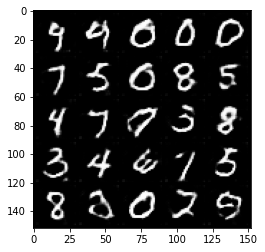

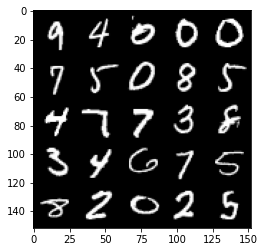

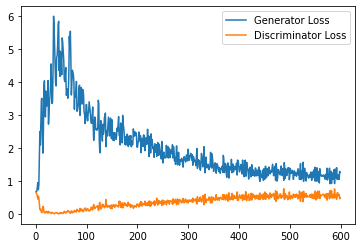

Step 12500: Generator loss: 1.109213075518608, discriminator loss: 0.5703825303316117


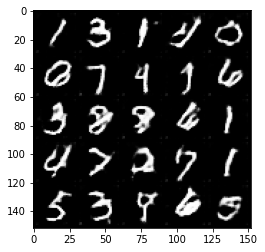

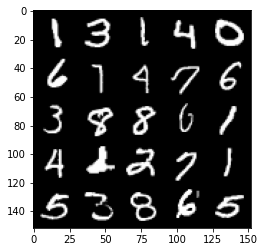

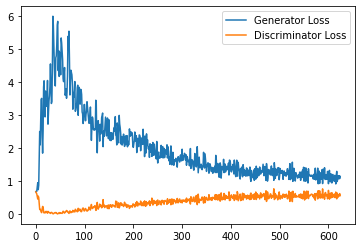

Step 13000: Generator loss: 1.137128342628479, discriminator loss: 0.5612047632336616


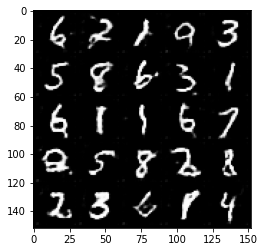

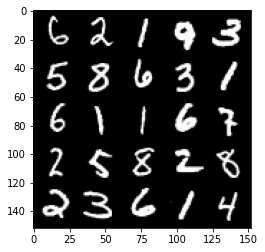

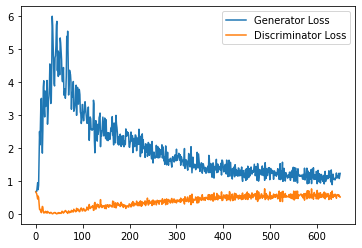

Step 13500: Generator loss: 1.1480893584489822, discriminator loss: 0.5619021971225738


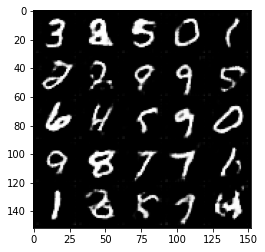

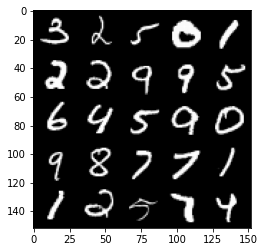

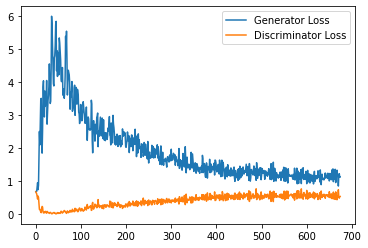

Step 14000: Generator loss: 1.073068057179451, discriminator loss: 0.576161094725132


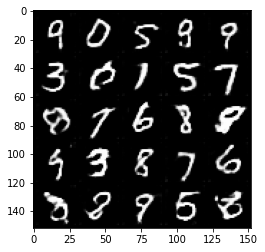

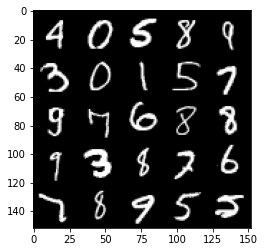

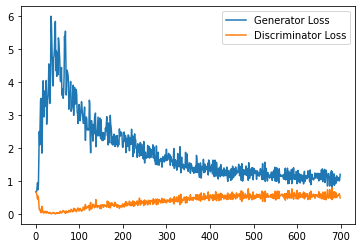

Step 14500: Generator loss: 1.1002791256904603, discriminator loss: 0.5747130756378174


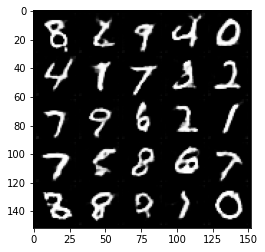

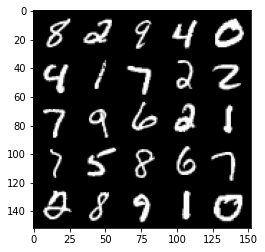

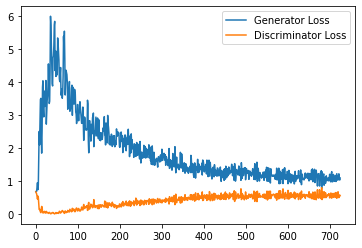

Step 15000: Generator loss: 1.1296127239465714, discriminator loss: 0.5778032515048981


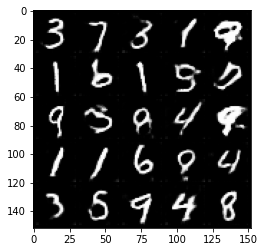

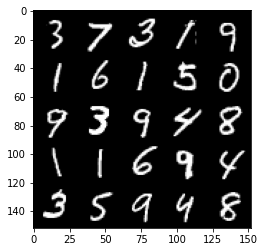

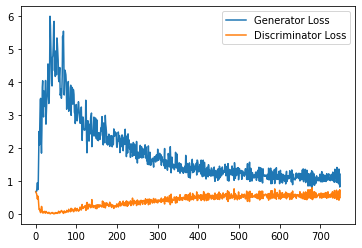

Step 15500: Generator loss: 1.0725378662347793, discriminator loss: 0.5780999060273171


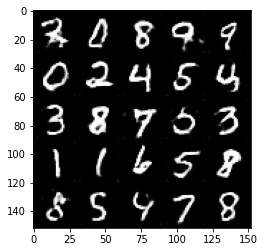

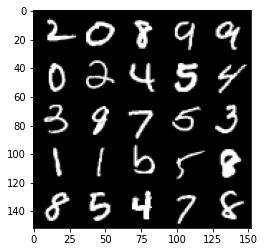

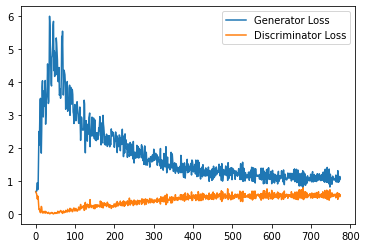

Step 16000: Generator loss: 1.080980105996132, discriminator loss: 0.578692141354084


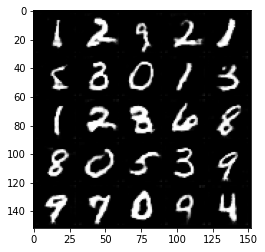

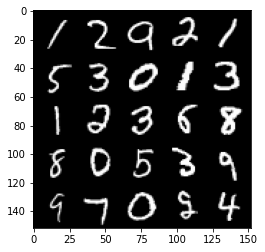

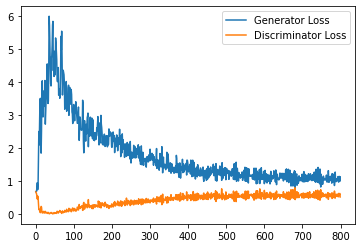

Step 16500: Generator loss: 1.0897588741779327, discriminator loss: 0.5832880068421363


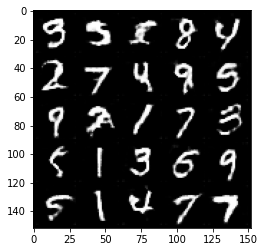

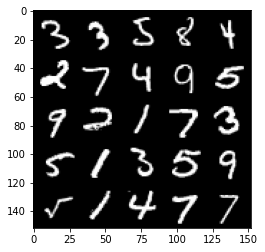

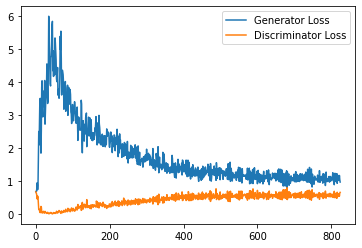

Step 17000: Generator loss: 1.1010325486660004, discriminator loss: 0.5772928057312965


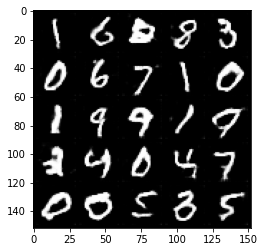

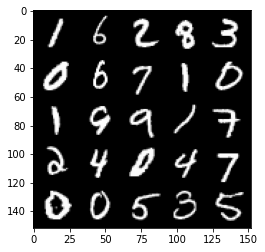

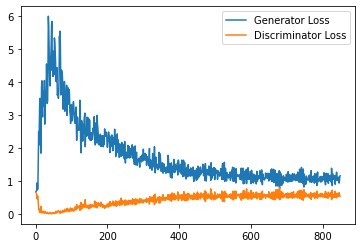

Step 17500: Generator loss: 1.0197470831871032, discriminator loss: 0.5862176932096481


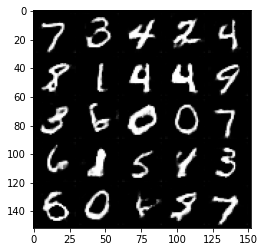

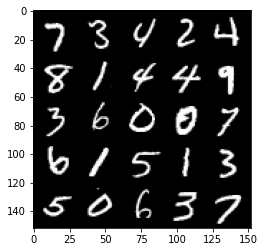

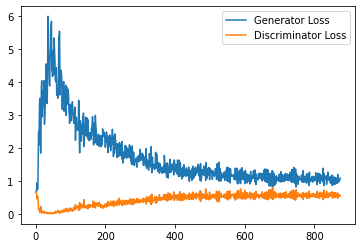

Step 18000: Generator loss: 1.0263077607154847, discriminator loss: 0.5900420583486558


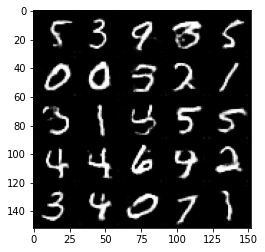

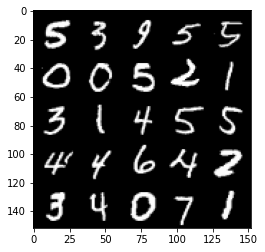

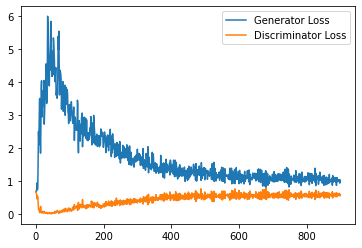

Step 18500: Generator loss: 1.0145623326301574, discriminator loss: 0.5894601892232895


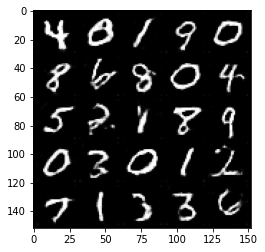

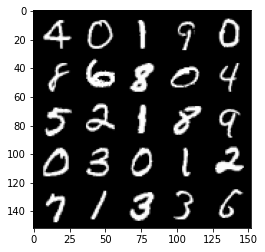

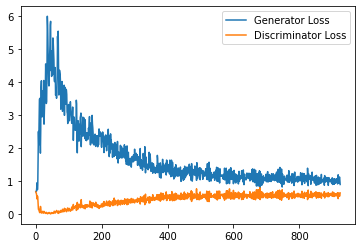

Step 19000: Generator loss: 1.0304938316345216, discriminator loss: 0.5871422851085663


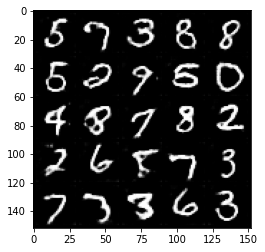

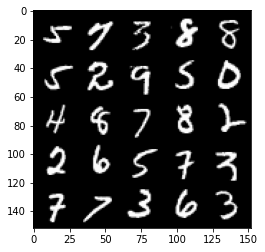

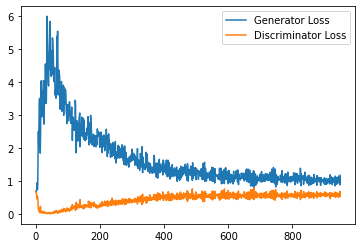

Step 19500: Generator loss: 1.045087511062622, discriminator loss: 0.5942577102184295


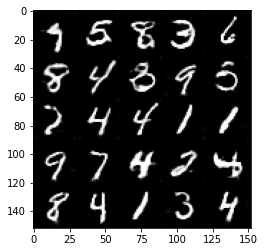

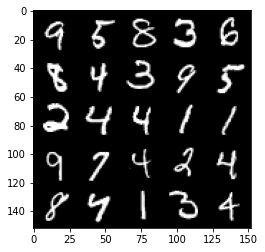

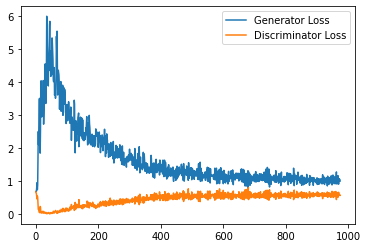

Step 20000: Generator loss: 1.01825703895092, discriminator loss: 0.5938125289082528


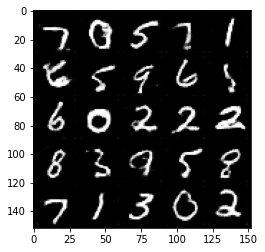

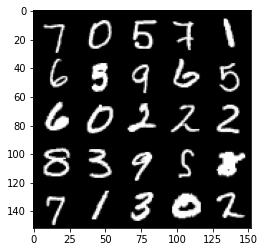

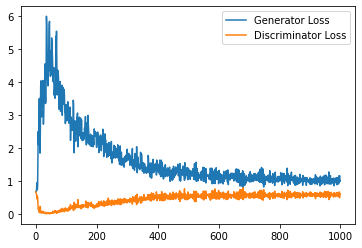

Step 20500: Generator loss: 1.021171328663826, discriminator loss: 0.5970215071439743


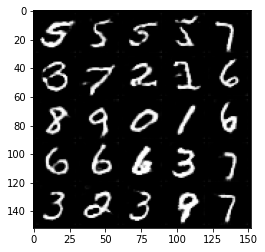

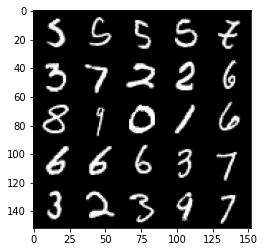

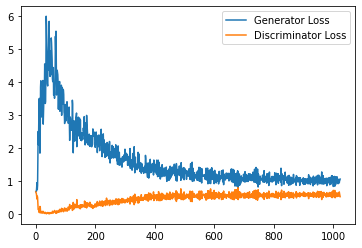

Step 21000: Generator loss: 1.0023221212625504, discriminator loss: 0.6048915927410126


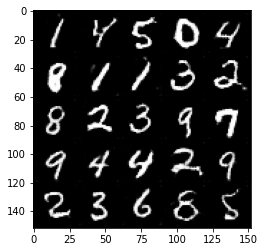

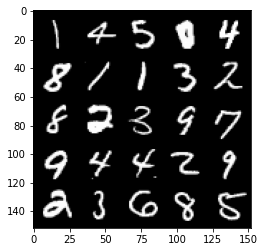

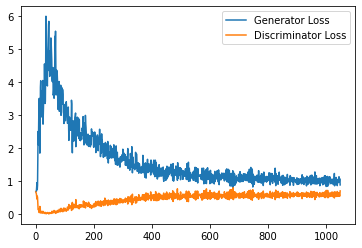

Step 21500: Generator loss: 1.0317791693210603, discriminator loss: 0.5967915748953819


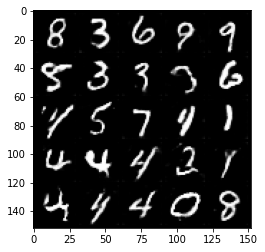

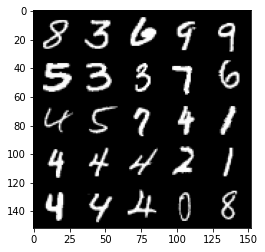

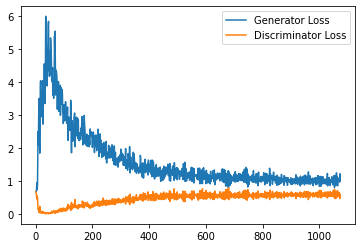

Step 22000: Generator loss: 0.9914083399772644, discriminator loss: 0.6016017066240311


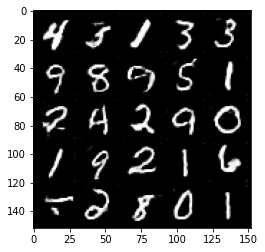

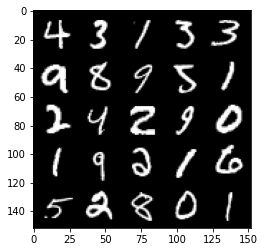

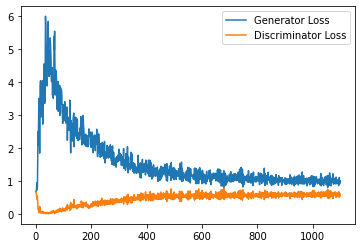

Step 22500: Generator loss: 0.9908308155536651, discriminator loss: 0.5952603372931481


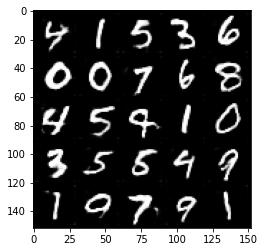

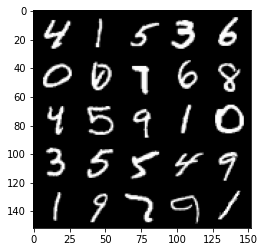

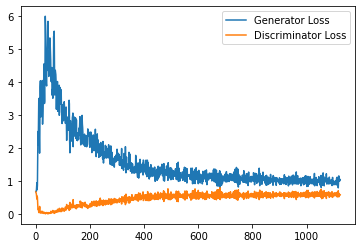

Step 23000: Generator loss: 1.012717411994934, discriminator loss: 0.6001476083397865


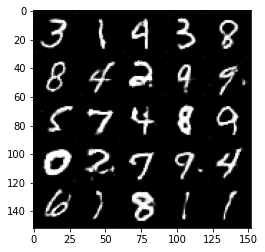

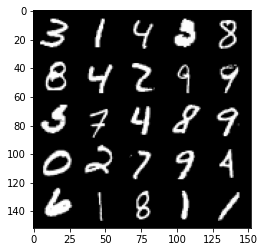

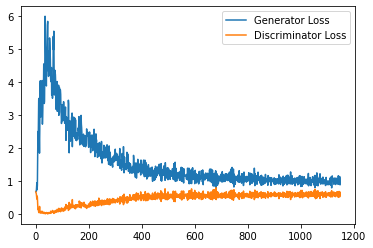

Step 23500: Generator loss: 1.0238083510398865, discriminator loss: 0.5985795366764068


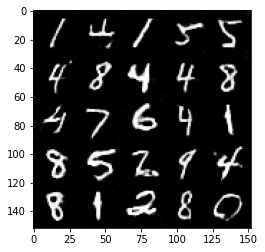

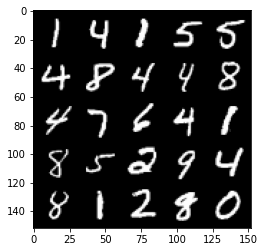

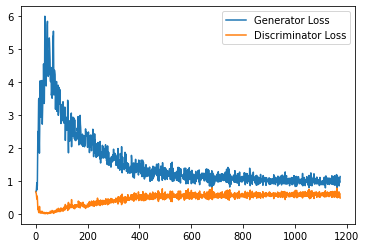

Step 24000: Generator loss: 1.0015434799194336, discriminator loss: 0.5983647419214249


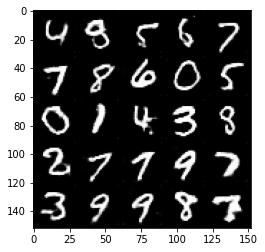

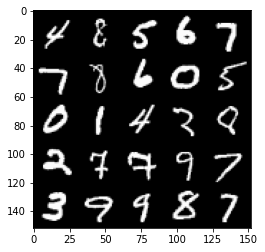

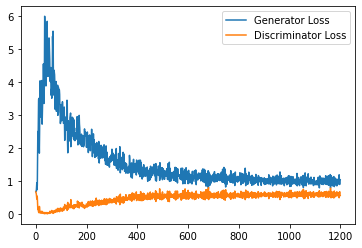

Step 24500: Generator loss: 1.014038735151291, discriminator loss: 0.5943125082850457


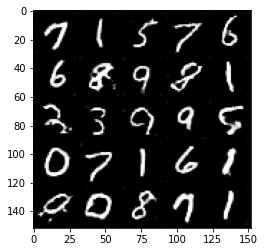

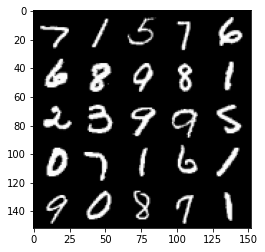

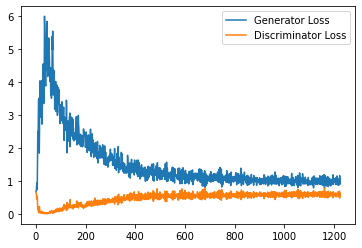

Step 25000: Generator loss: 0.9821696668863297, discriminator loss: 0.6026300694942475


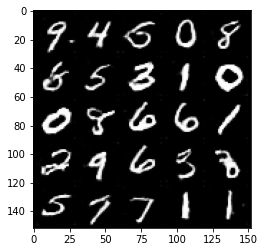

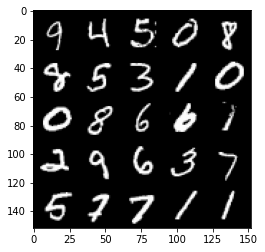

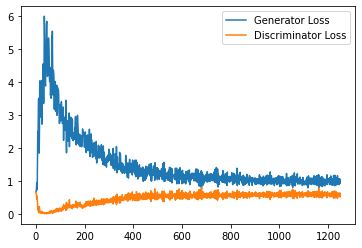

Step 25500: Generator loss: 0.9752019180059432, discriminator loss: 0.6018073431253433


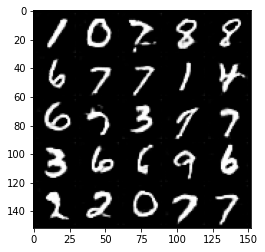

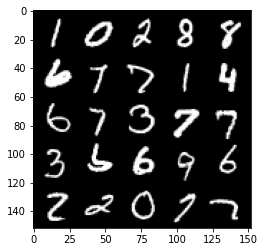

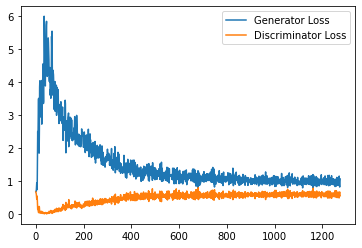

Step 26000: Generator loss: 0.9964465569257737, discriminator loss: 0.5979072803854942


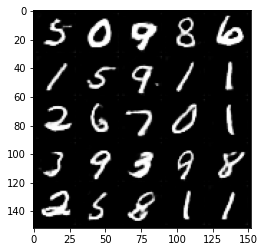

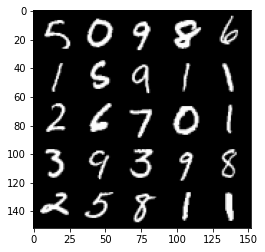

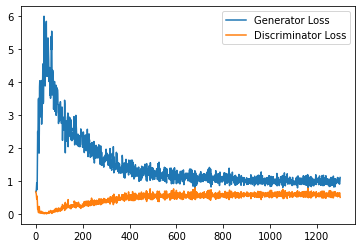

Step 26500: Generator loss: 0.9749517194032669, discriminator loss: 0.6083125475645065


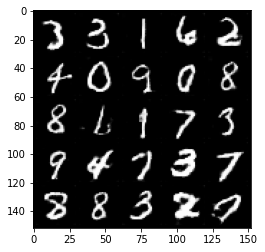

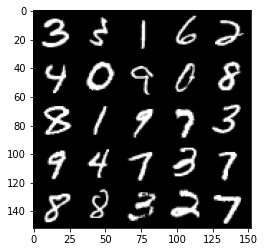

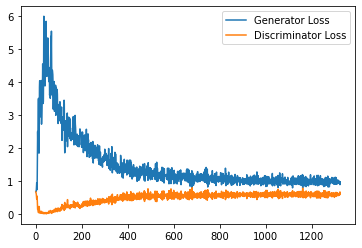

Step 27000: Generator loss: 0.992819953083992, discriminator loss: 0.5991395139694213


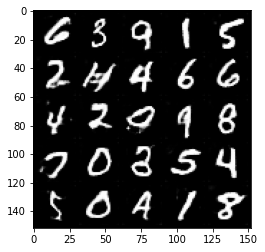

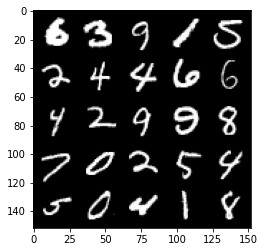

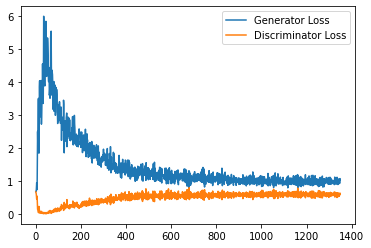

Step 27500: Generator loss: 1.0082447341680527, discriminator loss: 0.5998346429467202


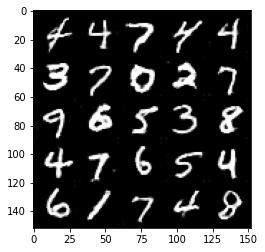

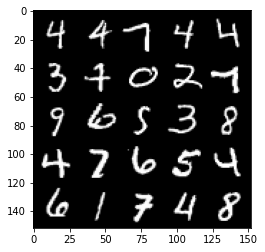

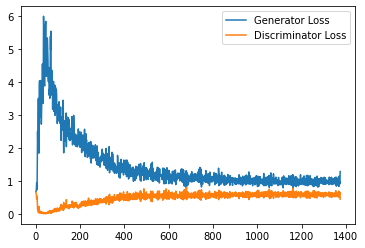

Step 28000: Generator loss: 1.0141597657203674, discriminator loss: 0.5962594413757324


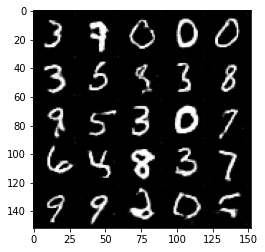

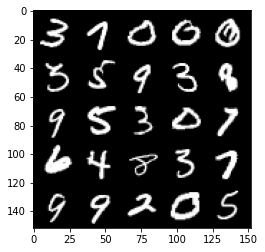

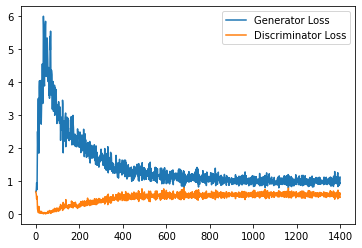

Step 28500: Generator loss: 0.9767523190975189, discriminator loss: 0.5934251782298088


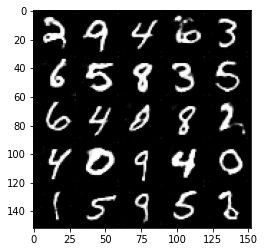

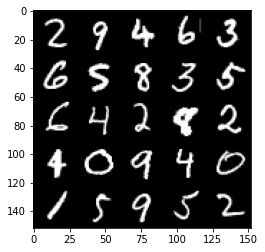

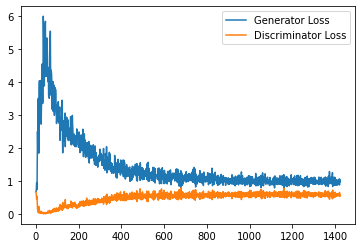

Step 29000: Generator loss: 1.0144578400850297, discriminator loss: 0.6017271001935005


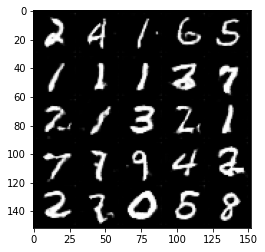

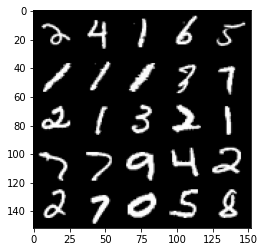

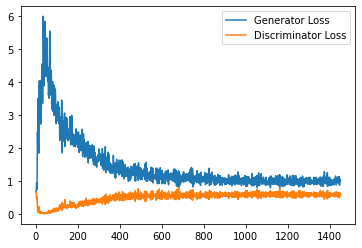

Step 29500: Generator loss: 1.002010648369789, discriminator loss: 0.5982890940904617


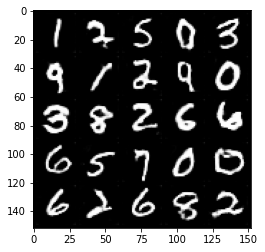

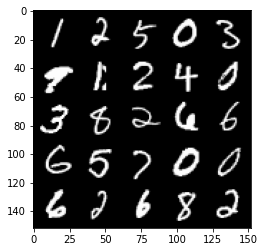

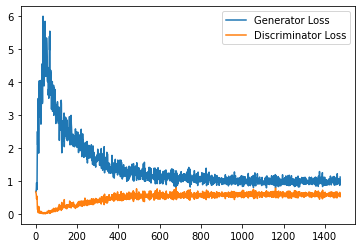

Step 30000: Generator loss: 0.9927145237922669, discriminator loss: 0.5976290394067765


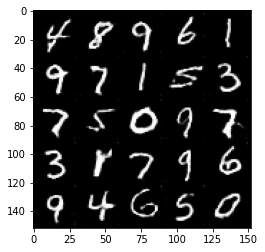

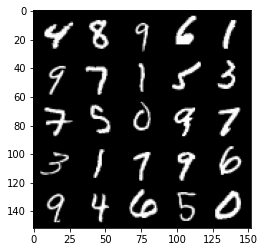

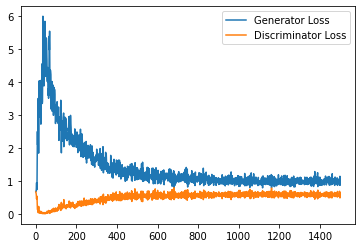

Step 30500: Generator loss: 1.004903674840927, discriminator loss: 0.5993873588442803


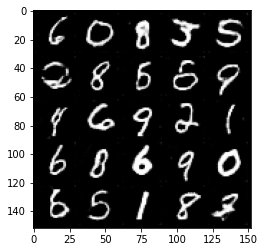

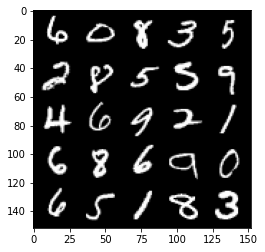

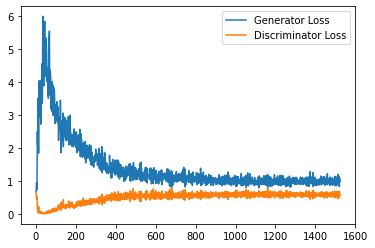

Step 31000: Generator loss: 1.0043385827541351, discriminator loss: 0.6005161117911338


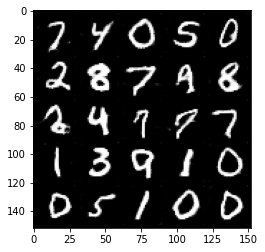

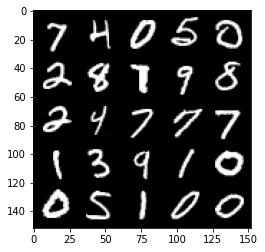

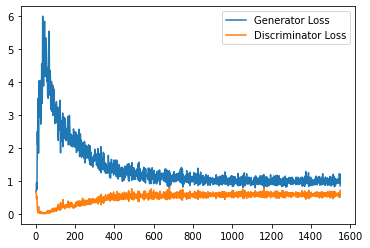

Step 31500: Generator loss: 1.0087059965133667, discriminator loss: 0.5931449546813965


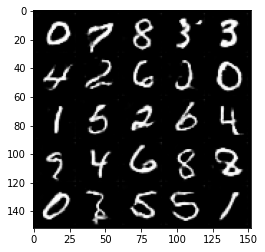

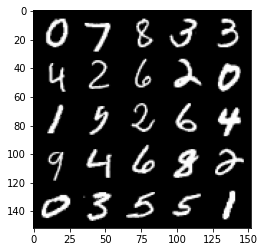

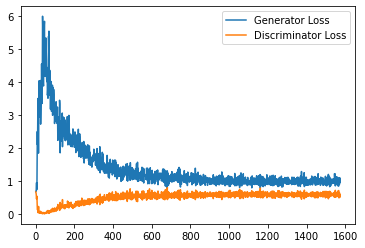

Step 32000: Generator loss: 0.9792617470026016, discriminator loss: 0.5998425835967064


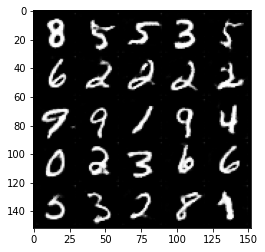

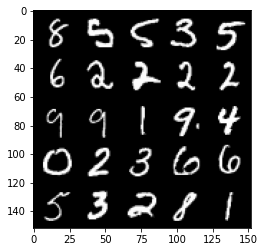

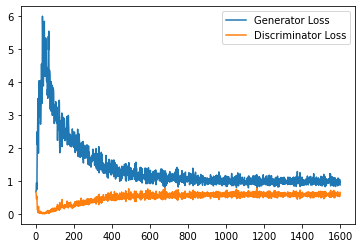

Step 32500: Generator loss: 0.9851404412984848, discriminator loss: 0.5953402286171913


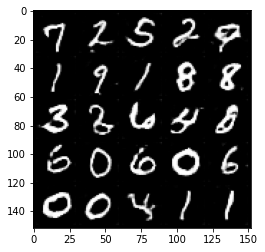

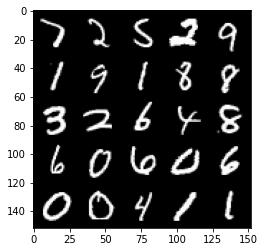

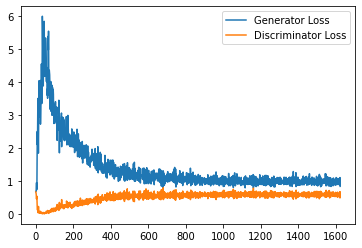

Step 33000: Generator loss: 0.9825580302476883, discriminator loss: 0.5935133438110352


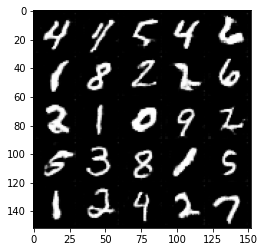

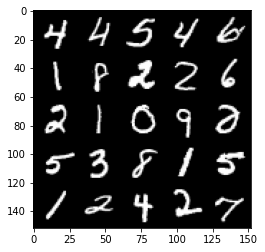

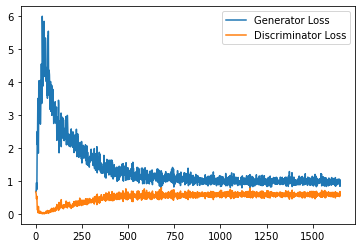

Step 33500: Generator loss: 0.9944436866044998, discriminator loss: 0.5923793580532074


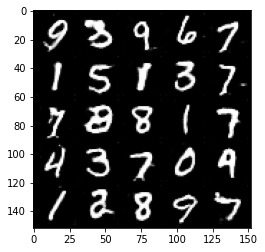

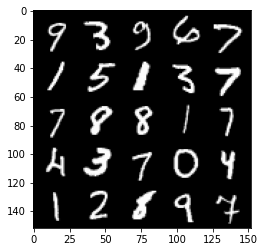

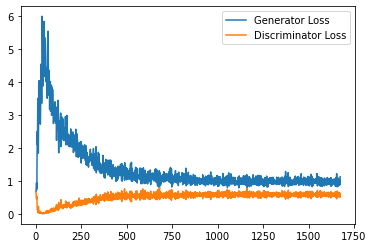

Step 34000: Generator loss: 0.9898915852308273, discriminator loss: 0.5923647439479828


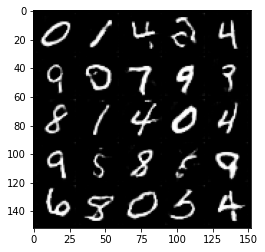

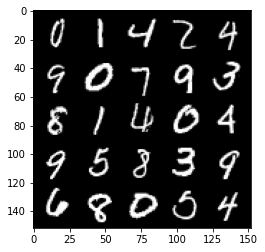

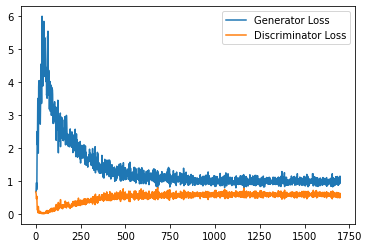

Step 34500: Generator loss: 0.9881702656745911, discriminator loss: 0.5964201704263687


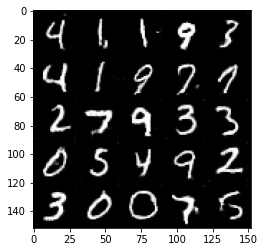

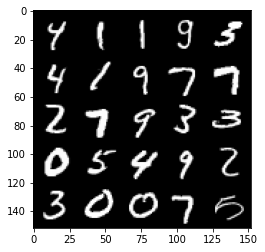

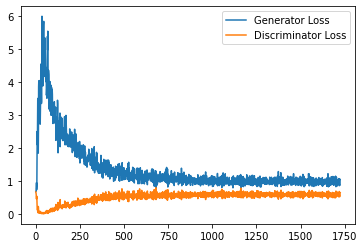

Step 35000: Generator loss: 1.0100736843347549, discriminator loss: 0.5924841567277909


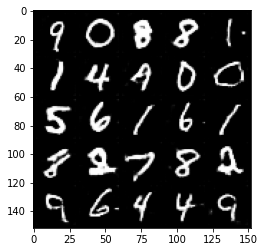

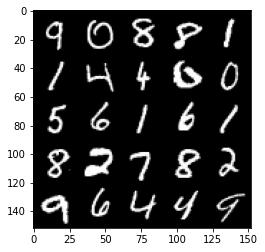

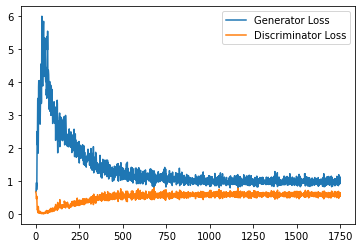

Step 35500: Generator loss: 0.9988482471704483, discriminator loss: 0.5902277618646622


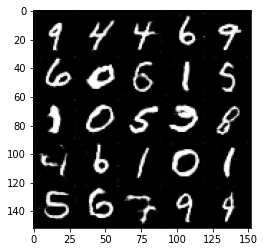

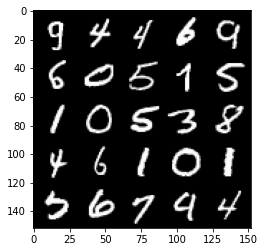

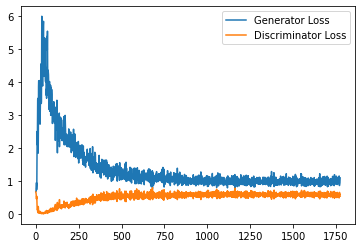

Step 36000: Generator loss: 1.0105291652679442, discriminator loss: 0.5913162475824356


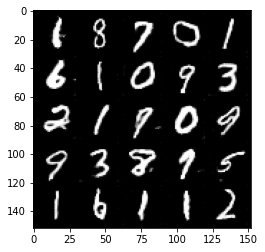

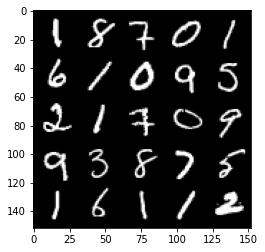

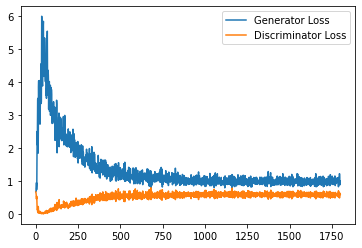

Step 36500: Generator loss: 0.9917318524122238, discriminator loss: 0.5908804194927215


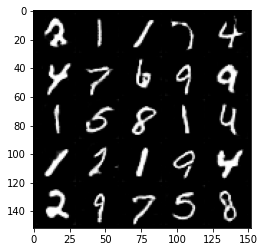

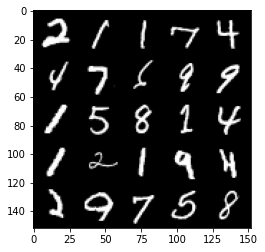

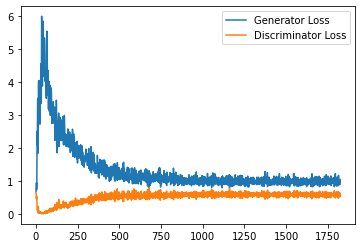

Step 37000: Generator loss: 0.9908498854637146, discriminator loss: 0.5900264363884926


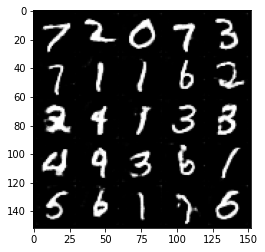

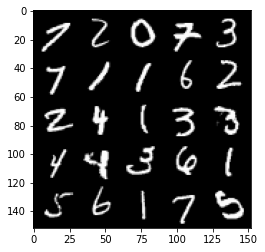

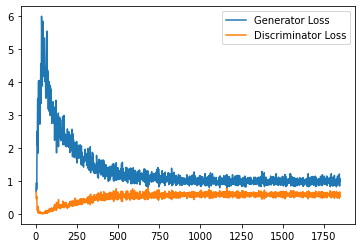

Step 37500: Generator loss: 0.986846195936203, discriminator loss: 0.5897341920733452


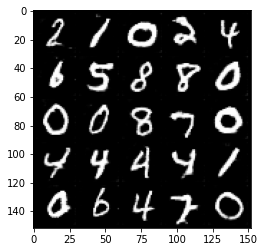

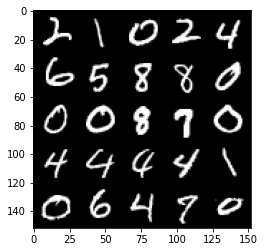

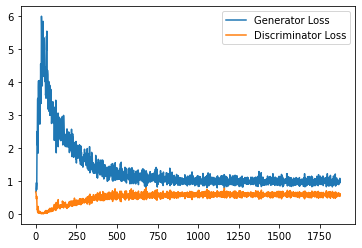

Step 38000: Generator loss: 1.016424972176552, discriminator loss: 0.5896590404510498


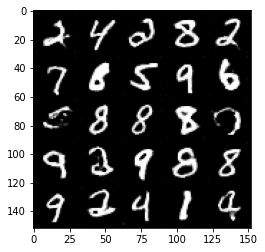

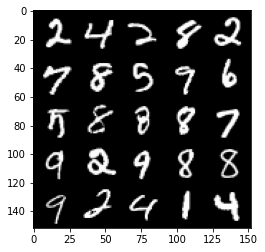

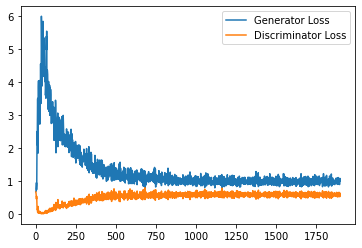

Step 38500: Generator loss: 1.004340628027916, discriminator loss: 0.5890856556892395


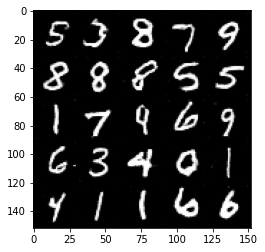

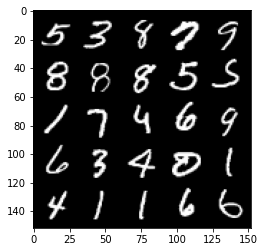

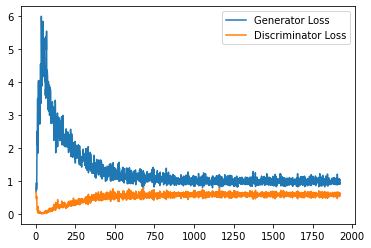

Step 39000: Generator loss: 0.9988246681690216, discriminator loss: 0.5841991985440255


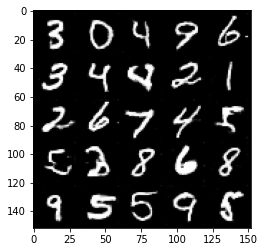

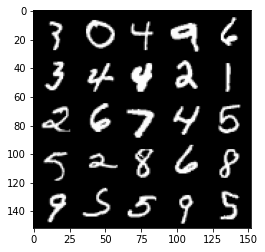

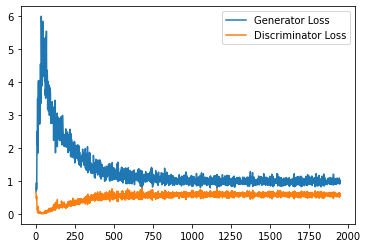

Step 39500: Generator loss: 1.023411688566208, discriminator loss: 0.5829175902009011


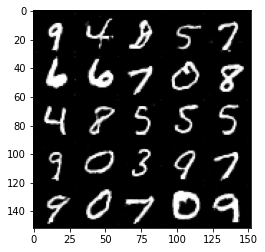

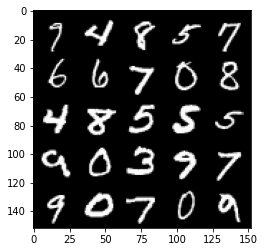

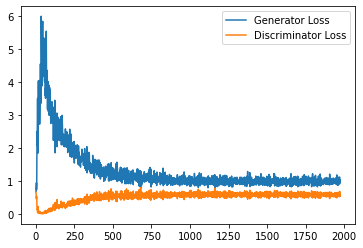

Step 40000: Generator loss: 1.0186996899843217, discriminator loss: 0.5827831020355224


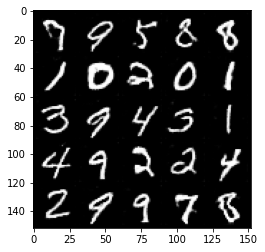

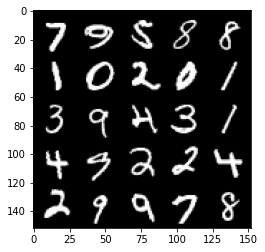

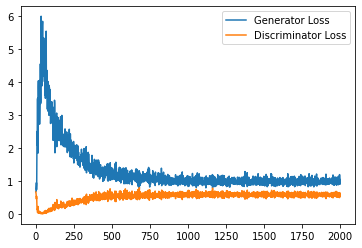

Step 40500: Generator loss: 1.0271059188842773, discriminator loss: 0.5786256299614906


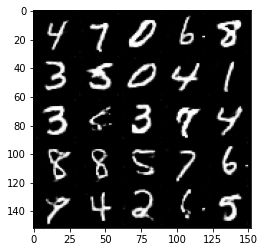

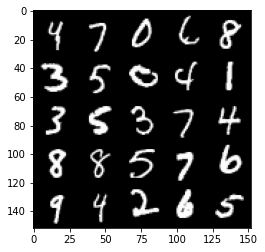

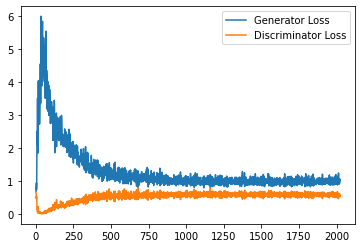

Step 41000: Generator loss: 1.0140781154632568, discriminator loss: 0.5807898631691932


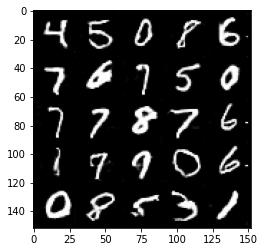

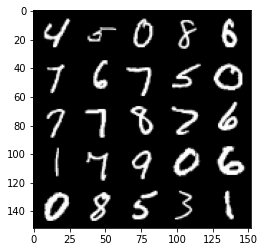

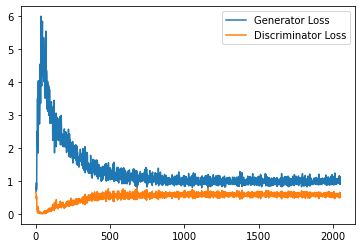

Step 41500: Generator loss: 1.0102186027765274, discriminator loss: 0.576792005598545


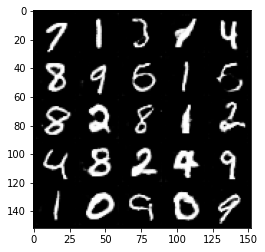

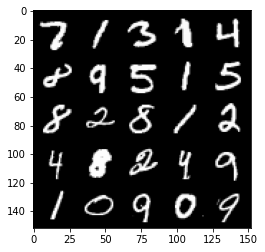

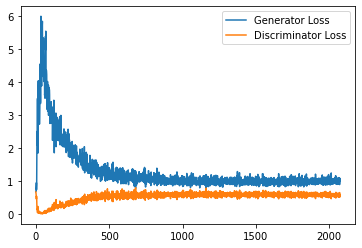

Step 42000: Generator loss: 1.0183489824533463, discriminator loss: 0.580834494292736


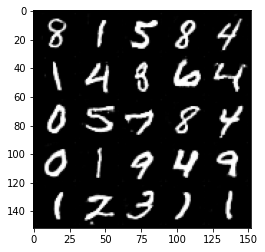

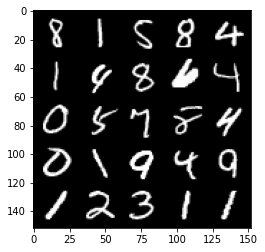

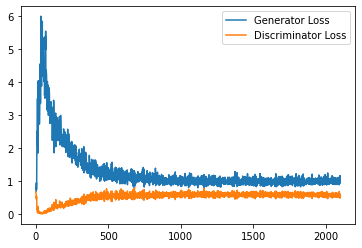

Step 42500: Generator loss: 1.0218074123859406, discriminator loss: 0.578116091966629


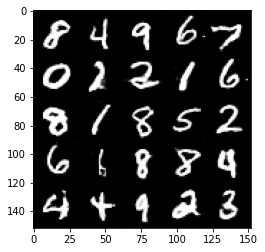

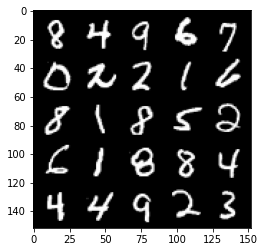

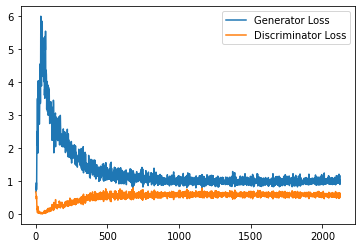

Step 43000: Generator loss: 1.015411596775055, discriminator loss: 0.578875143647194


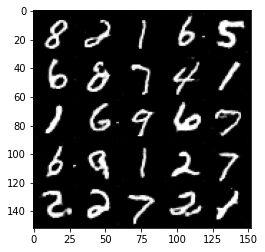

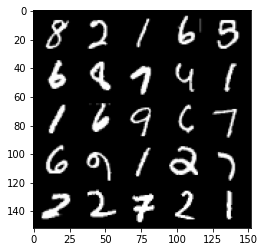

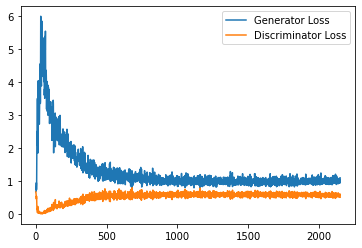

Step 43500: Generator loss: 1.0534304537773131, discriminator loss: 0.5733509083986282


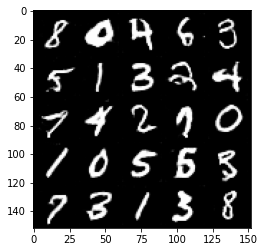

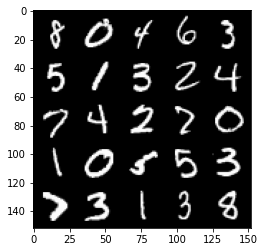

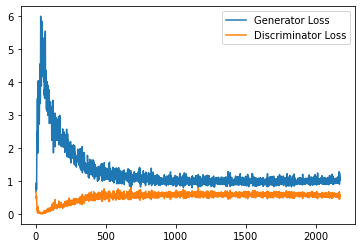

Step 44000: Generator loss: 1.0302909095287323, discriminator loss: 0.574060350716114


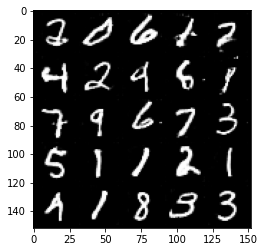

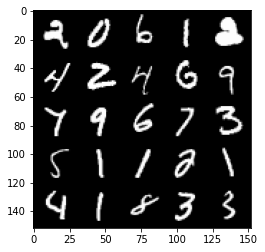

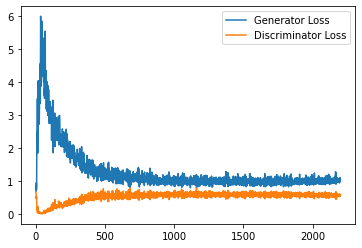

Step 44500: Generator loss: 1.0336731734275817, discriminator loss: 0.576069589138031


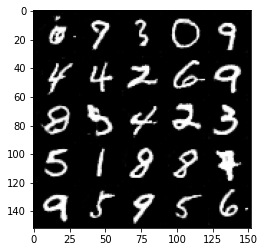

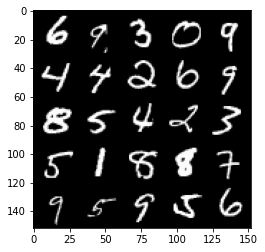

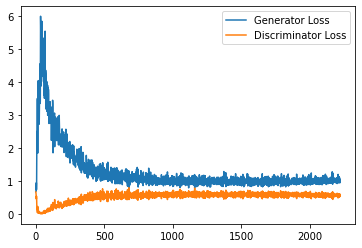

Step 45000: Generator loss: 1.0312018634080886, discriminator loss: 0.5803564763665199


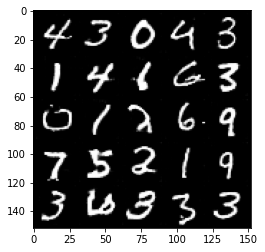

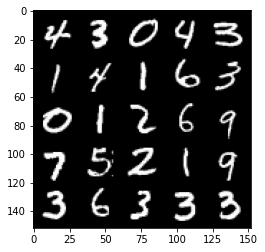

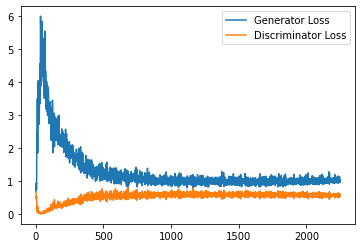

Step 45500: Generator loss: 1.0496567336320877, discriminator loss: 0.5703283142447472


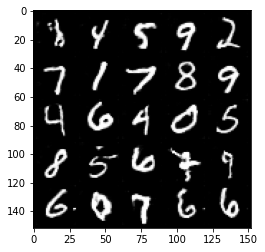

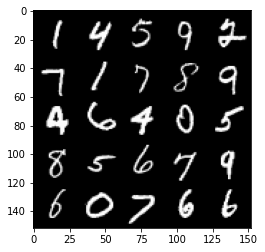

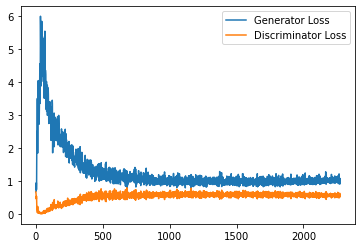

Step 46000: Generator loss: 1.0220831764936447, discriminator loss: 0.5756674471497536


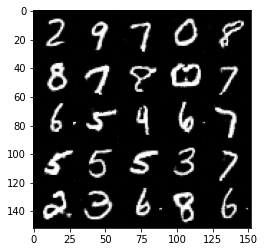

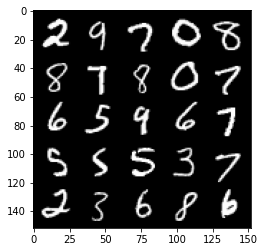

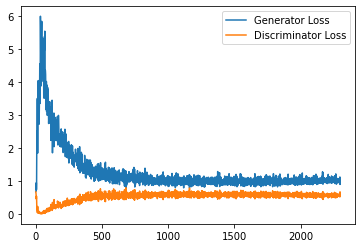

Step 46500: Generator loss: 1.058577249288559, discriminator loss: 0.5686940200328827


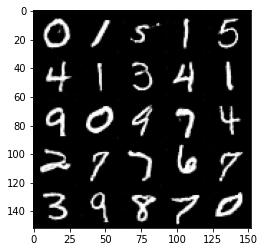

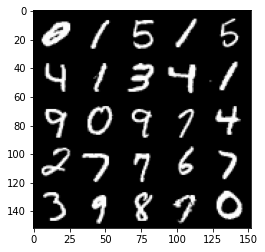

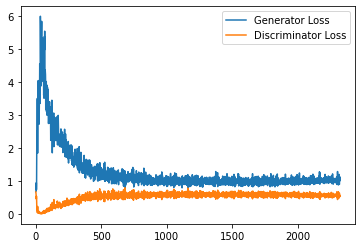

Step 47000: Generator loss: 1.0300492000579835, discriminator loss: 0.5763730829954148


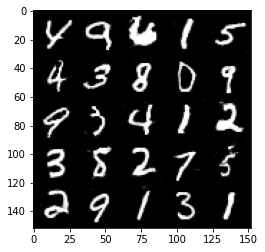

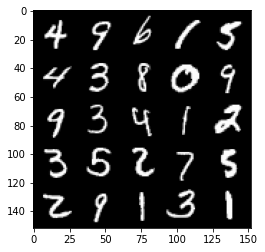

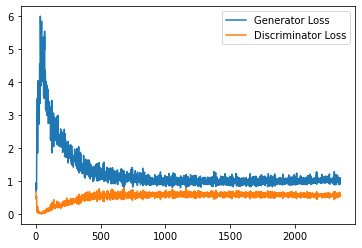

Step 47500: Generator loss: 1.0417882999181747, discriminator loss: 0.5721708879470825


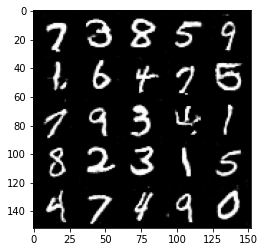

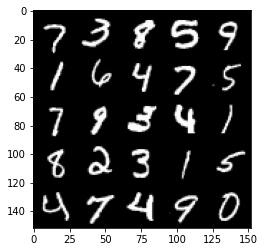

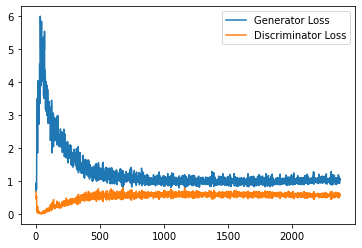

Step 48000: Generator loss: 1.0621648495197296, discriminator loss: 0.5710316455960274


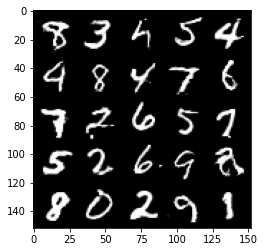

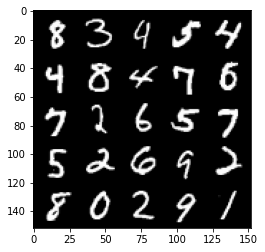

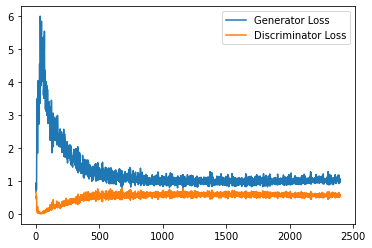

Step 48500: Generator loss: 1.022742152929306, discriminator loss: 0.5697408783435821


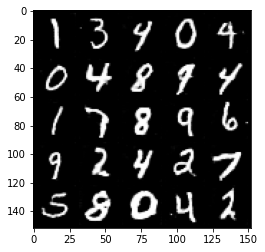

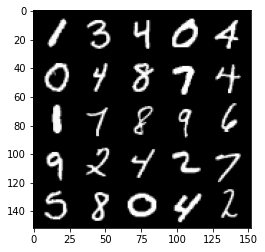

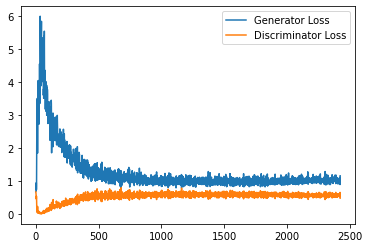

Step 49000: Generator loss: 1.0510269758701325, discriminator loss: 0.5678903171420098


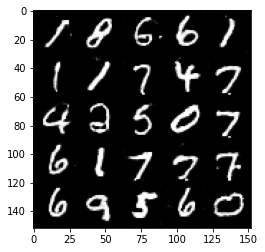

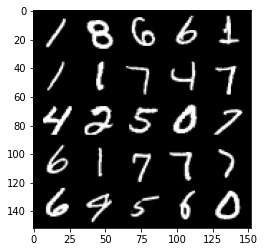

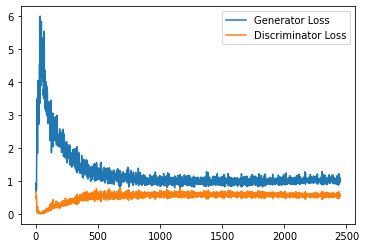

Step 49500: Generator loss: 1.0635113382339478, discriminator loss: 0.5687871196866036


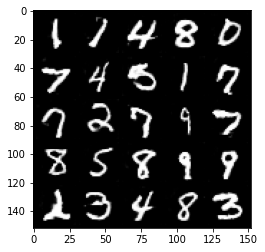

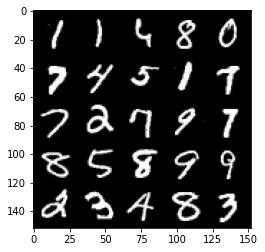

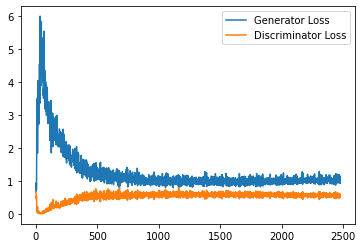

Step 50000: Generator loss: 1.0537999213933944, discriminator loss: 0.5666565566658973


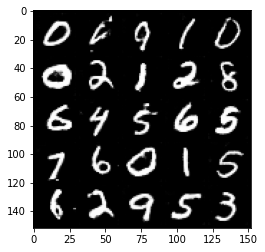

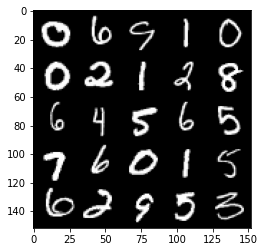

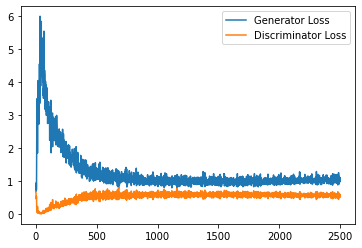

Step 50500: Generator loss: 1.0454503104686736, discriminator loss: 0.5683629859089852


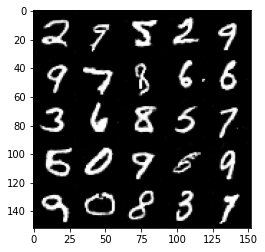

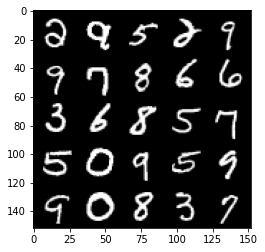

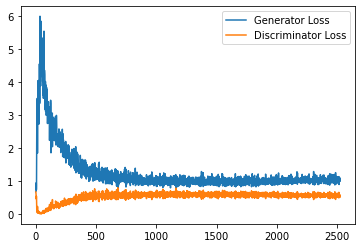

Step 51000: Generator loss: 1.0383290400505065, discriminator loss: 0.5714131036996841


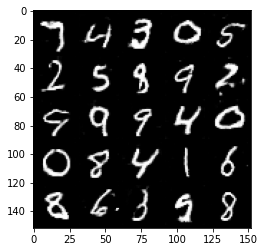

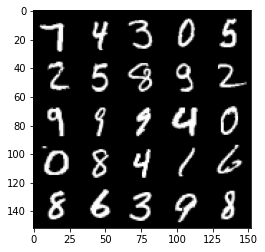

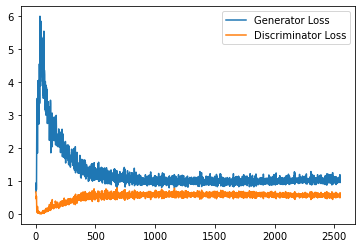

Step 51500: Generator loss: 1.089767690896988, discriminator loss: 0.5630418968200683


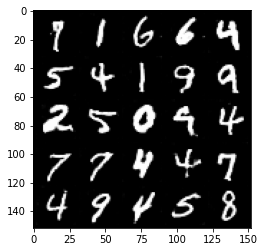

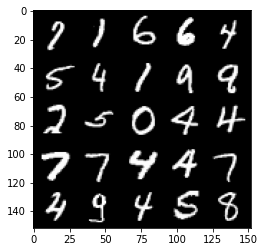

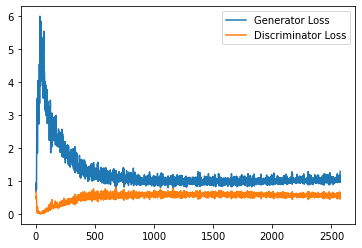

Step 52000: Generator loss: 1.0688767911195756, discriminator loss: 0.5697151561975479


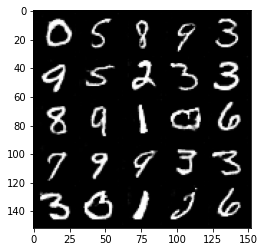

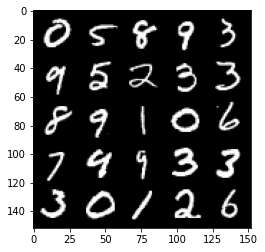

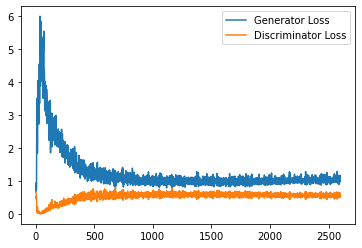

Step 52500: Generator loss: 1.050970348596573, discriminator loss: 0.568758178293705


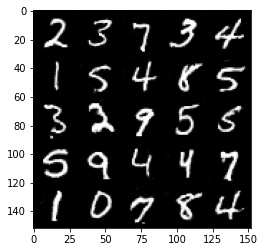

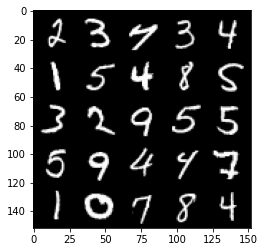

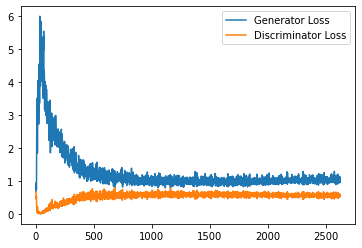

Step 53000: Generator loss: 1.0651007803678512, discriminator loss: 0.5703715500235558


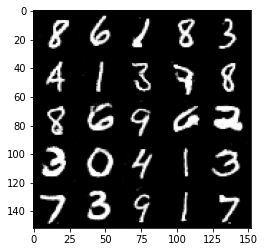

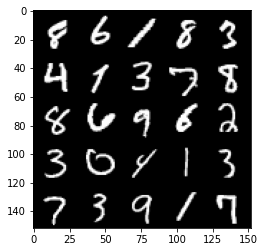

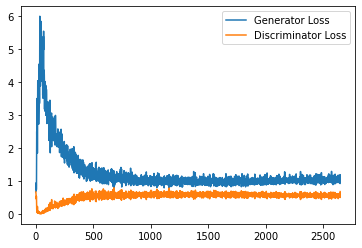

Step 53500: Generator loss: 1.0796377987861634, discriminator loss: 0.562663617014885


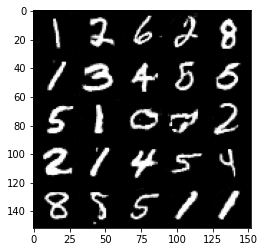

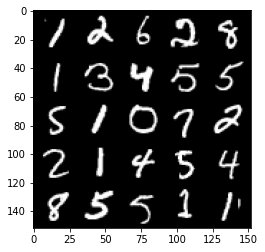

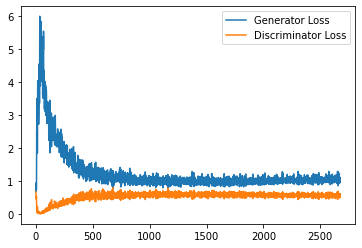

Step 54000: Generator loss: 1.048754998922348, discriminator loss: 0.5645425882339478


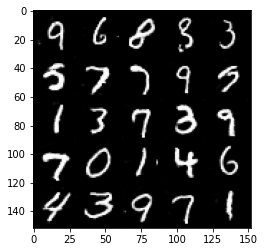

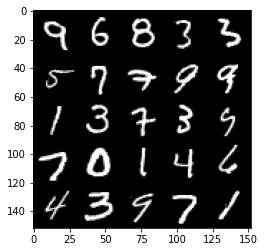

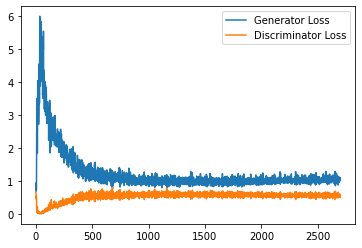

Step 54500: Generator loss: 1.0638078229427337, discriminator loss: 0.5655166887640953


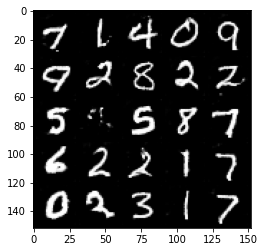

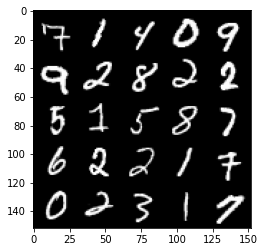

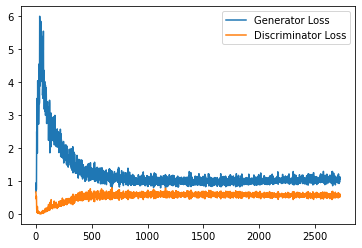

Step 55000: Generator loss: 1.0638162115812302, discriminator loss: 0.5657019927501679


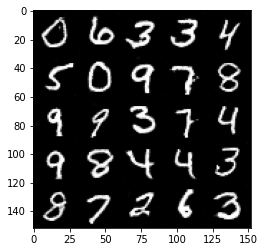

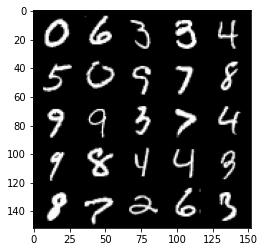

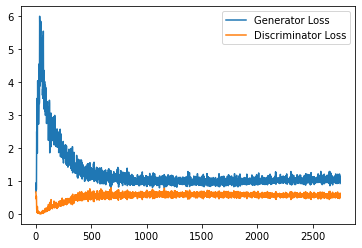

Step 55500: Generator loss: 1.0744543050527573, discriminator loss: 0.5598484851121902


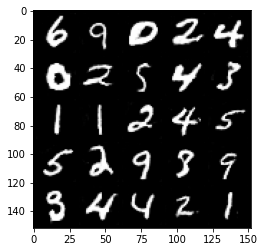

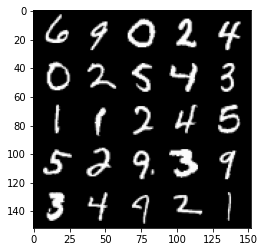

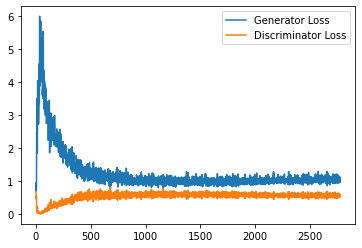

Step 56000: Generator loss: 1.0741844996213914, discriminator loss: 0.5670010314583779


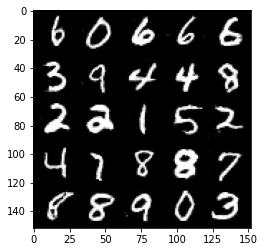

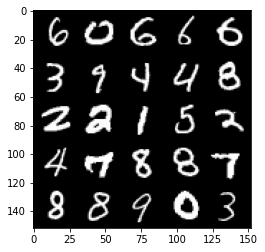

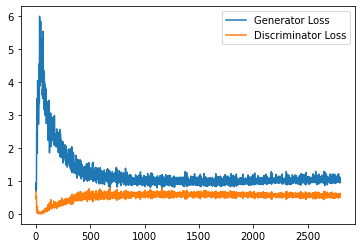

Step 56500: Generator loss: 1.0755767942667007, discriminator loss: 0.561091527044773


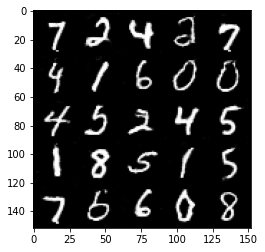

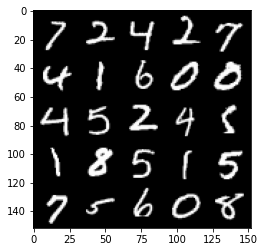

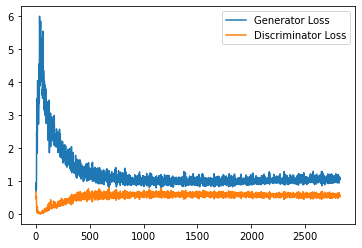

Step 57000: Generator loss: 1.0625348356962203, discriminator loss: 0.5619774973392486


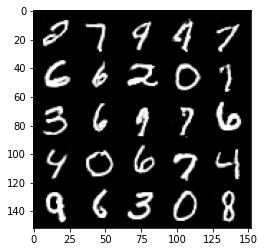

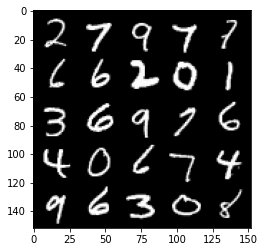

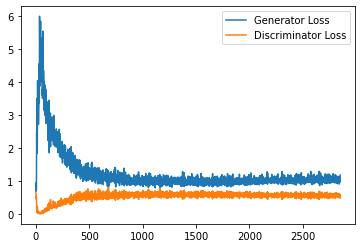

Step 57500: Generator loss: 1.0752723301649094, discriminator loss: 0.5666618272066116


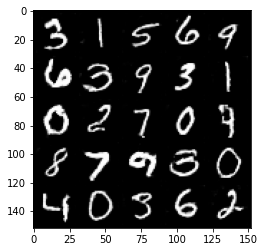

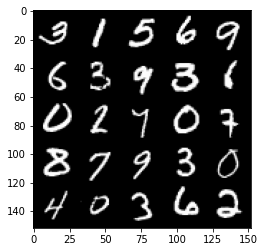

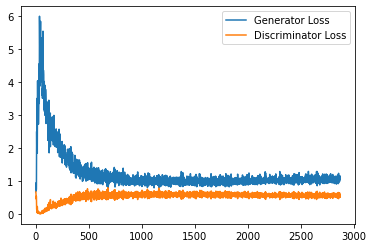

Step 58000: Generator loss: 1.0774929896593093, discriminator loss: 0.5610431614518165


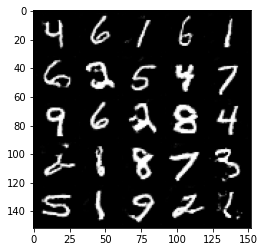

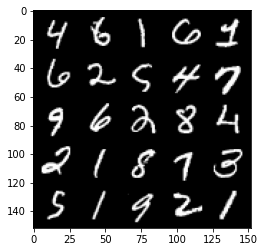

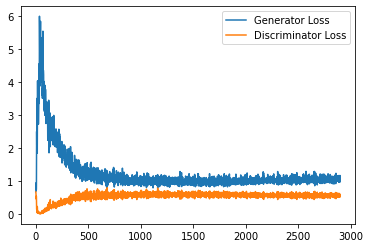

Step 58500: Generator loss: 1.1068355959653855, discriminator loss: 0.5627240571379661


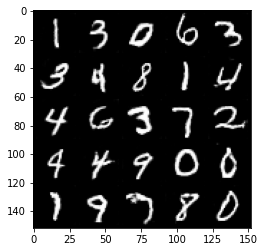

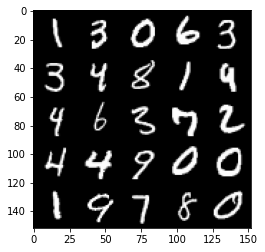

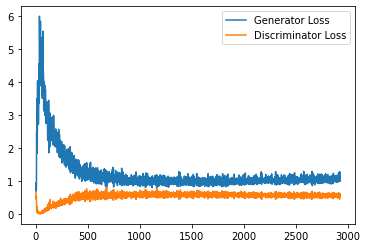

Step 59000: Generator loss: 1.0787587604522706, discriminator loss: 0.562821007668972


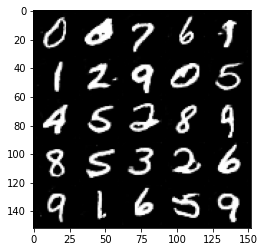

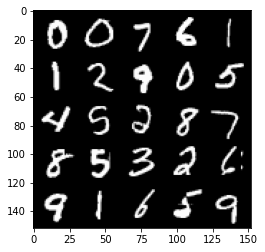

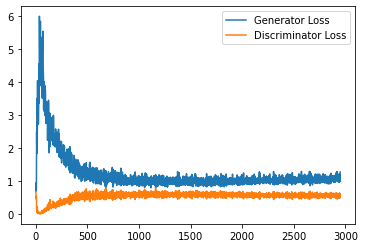

Step 59500: Generator loss: 1.0747996553182602, discriminator loss: 0.5640839279294014


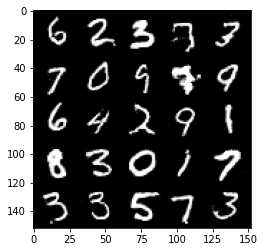

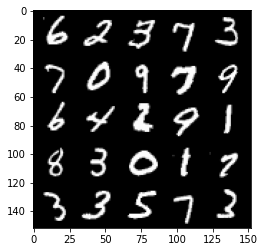

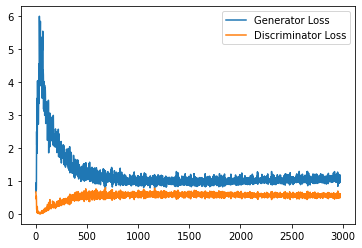

Step 60000: Generator loss: 1.0821170094013215, discriminator loss: 0.5643101292848587


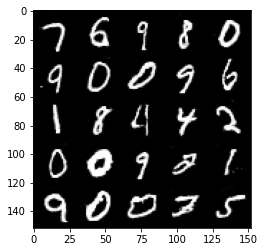

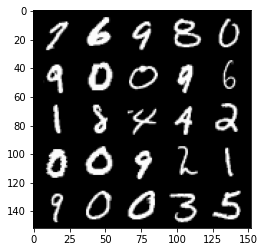

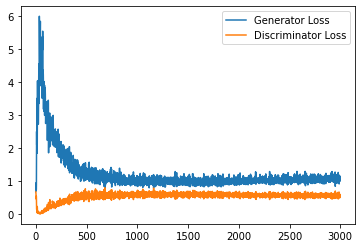

Step 60500: Generator loss: 1.0886936004161836, discriminator loss: 0.5618534196019173


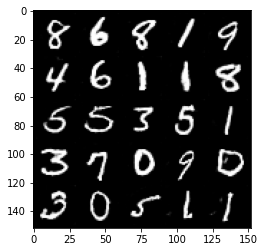

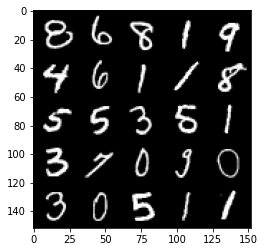

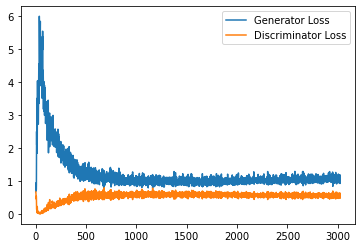

Step 61000: Generator loss: 1.0691148289442063, discriminator loss: 0.5639218776226044


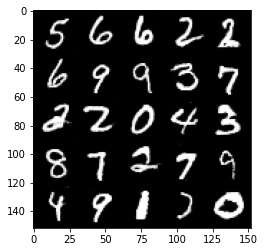

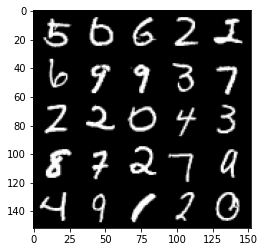

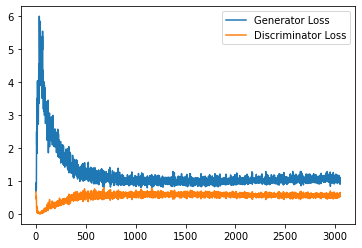

Step 61500: Generator loss: 1.079163587808609, discriminator loss: 0.561373232781887


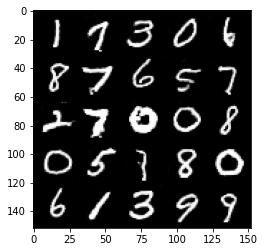

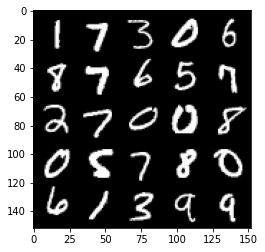

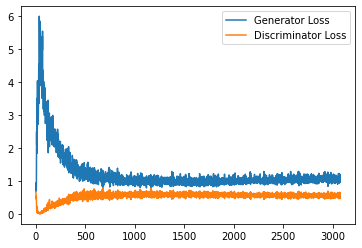

Step 62000: Generator loss: 1.1026477488279343, discriminator loss: 0.5625950521230698


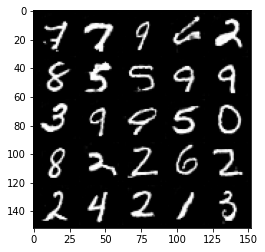

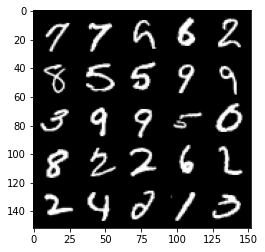

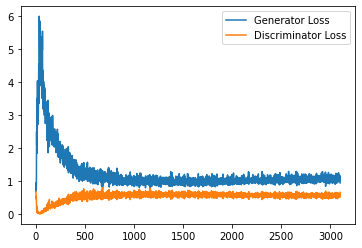

Step 62500: Generator loss: 1.0997390364408492, discriminator loss: 0.5627214725017547


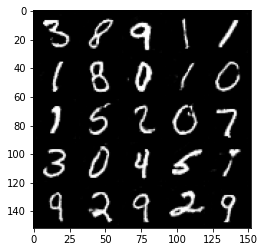

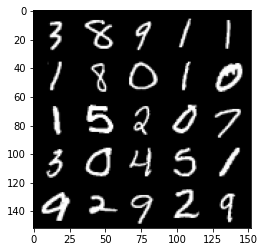

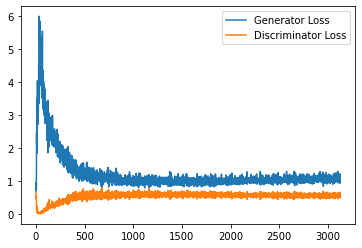

Step 63000: Generator loss: 1.0749863407611846, discriminator loss: 0.5683353136181831


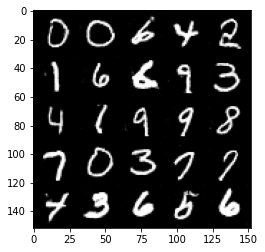

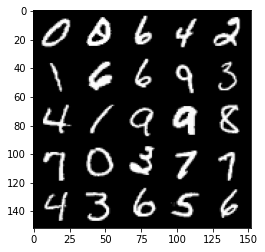

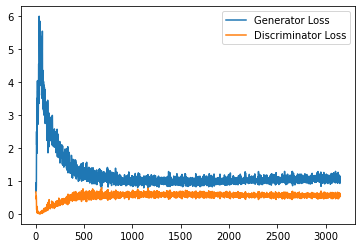

Step 63500: Generator loss: 1.0734233375787734, discriminator loss: 0.5613002354502677


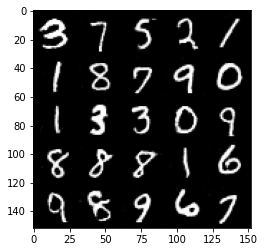

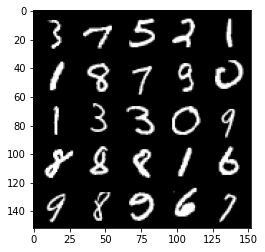

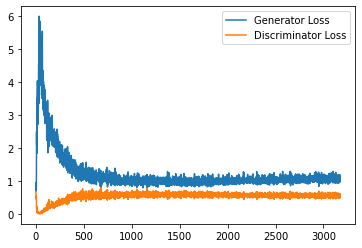

Step 64000: Generator loss: 1.0888818689584732, discriminator loss: 0.561311483502388


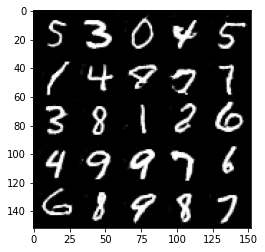

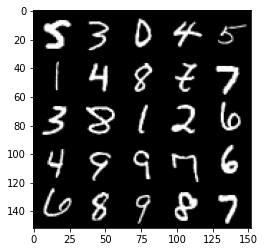

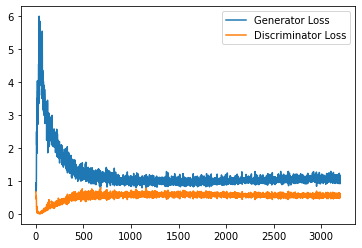

Step 64500: Generator loss: 1.0797049560546874, discriminator loss: 0.5659125955700874


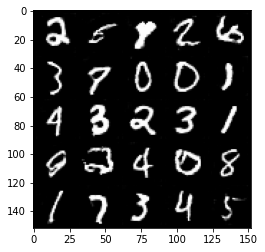

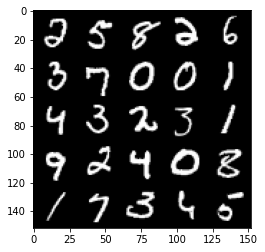

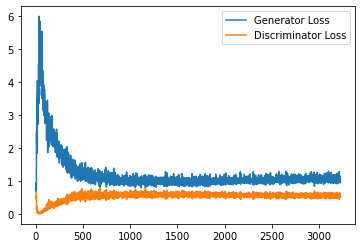

Step 65000: Generator loss: 1.0767865753173829, discriminator loss: 0.5618387675881386


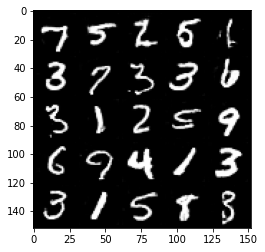

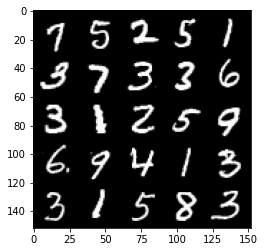

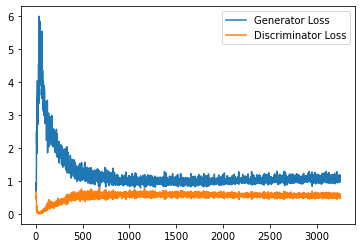

Step 65500: Generator loss: 1.0912560986280442, discriminator loss: 0.5619581090211868


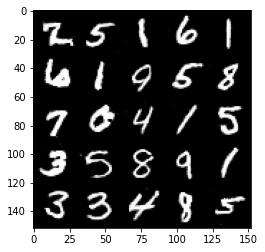

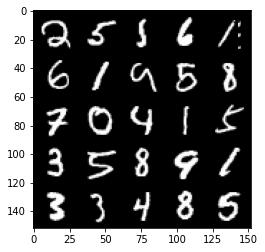

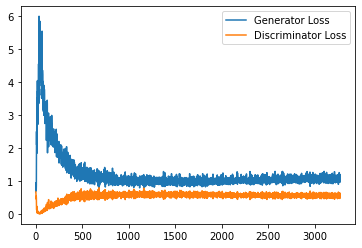

Step 66000: Generator loss: 1.0892951904535293, discriminator loss: 0.5635787796378136


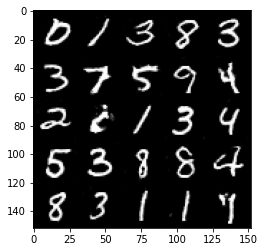

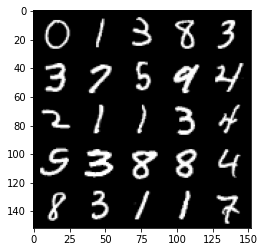

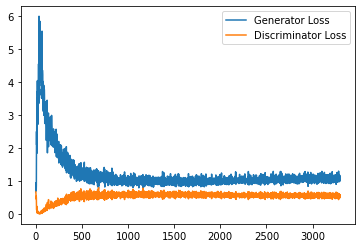

Step 66500: Generator loss: 1.0843250858783722, discriminator loss: 0.5687677617073059


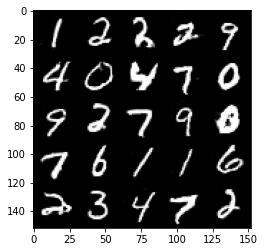

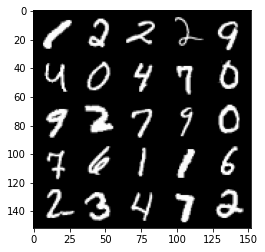

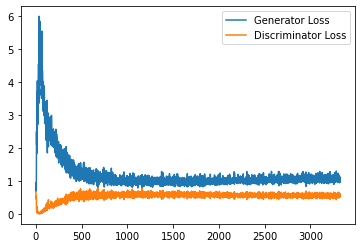

Step 67000: Generator loss: 1.0863907101154326, discriminator loss: 0.5699390048384666


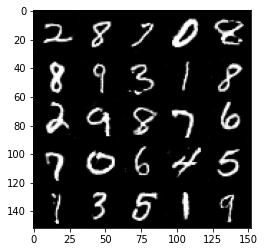

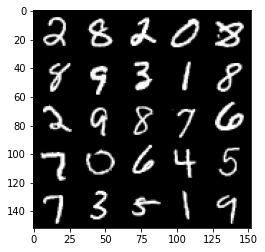

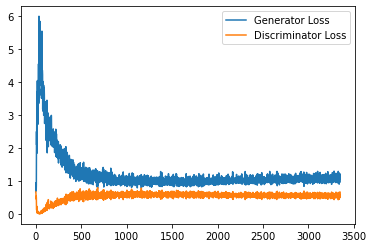

Step 67500: Generator loss: 1.0922446850538254, discriminator loss: 0.5646413146257401


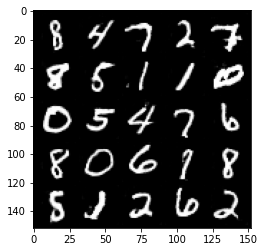

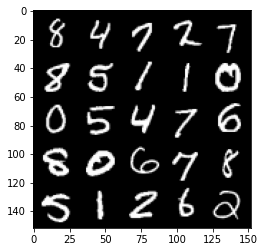

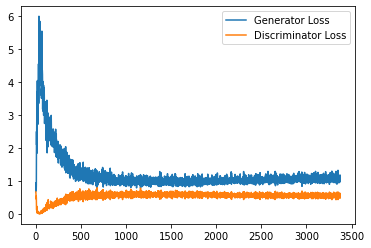

Step 68000: Generator loss: 1.0652158486843109, discriminator loss: 0.5714616321921349


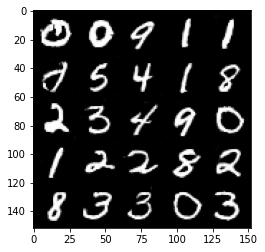

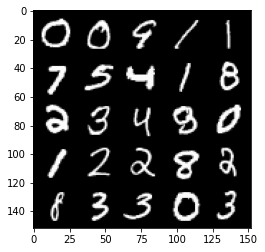

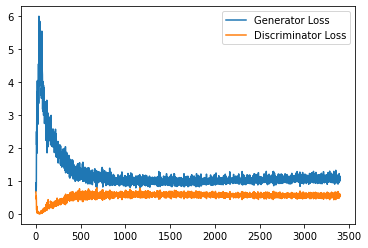

Step 68500: Generator loss: 1.0792773816585541, discriminator loss: 0.5652621309757233


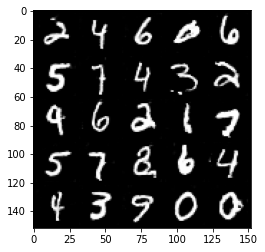

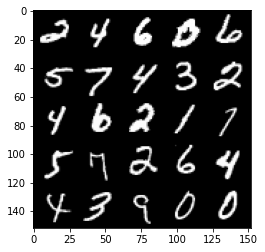

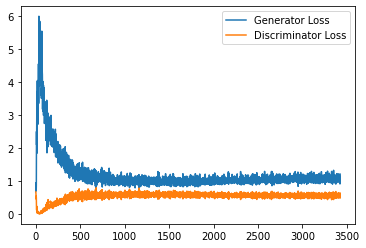

Step 69000: Generator loss: 1.0734720331430436, discriminator loss: 0.567146288216114


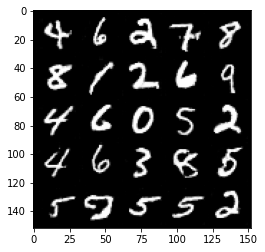

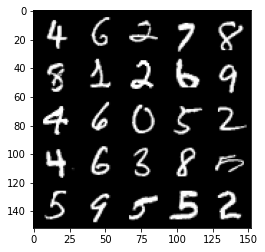

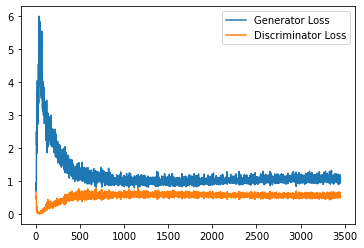

Step 69500: Generator loss: 1.0814548910856248, discriminator loss: 0.5687001089453697


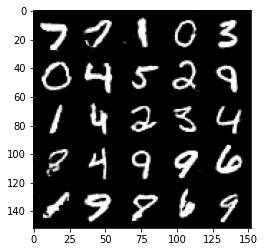

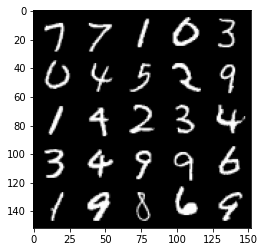

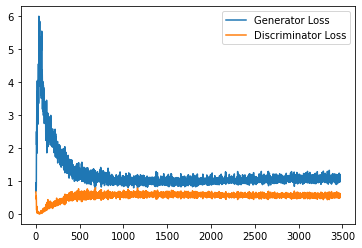

Step 70000: Generator loss: 1.0740271376371384, discriminator loss: 0.5720216301083565


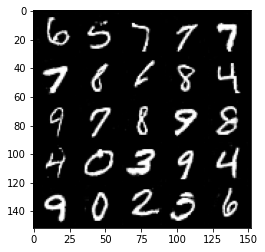

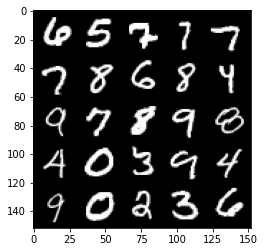

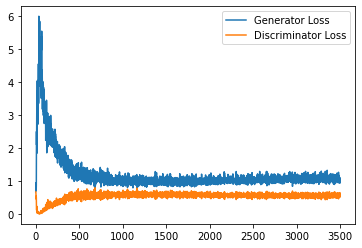

Step 70500: Generator loss: 1.0778600697517395, discriminator loss: 0.5749373136758804


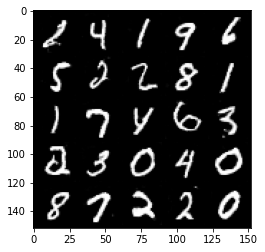

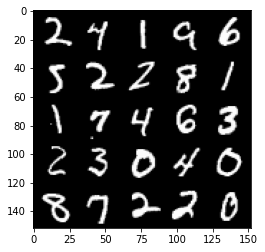

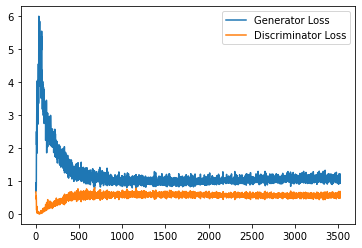

Step 71000: Generator loss: 1.070197975039482, discriminator loss: 0.5691563171148301


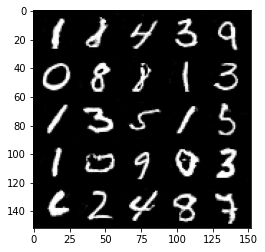

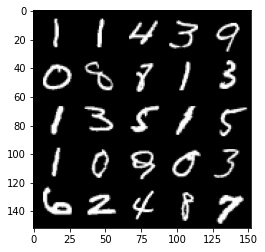

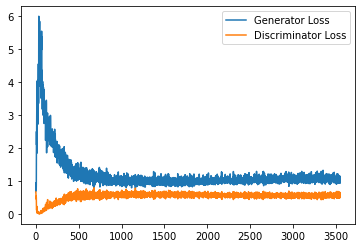

Step 71500: Generator loss: 1.0866759490966797, discriminator loss: 0.572410391330719


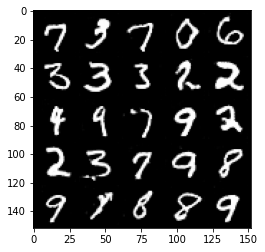

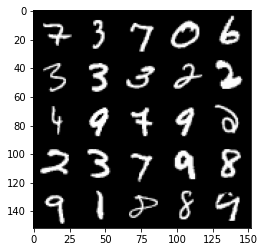

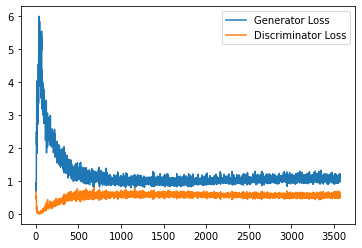

Step 72000: Generator loss: 1.0662354731559753, discriminator loss: 0.5806377495527267


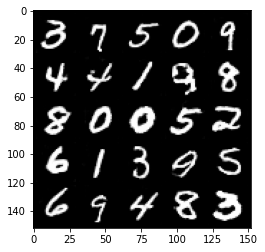

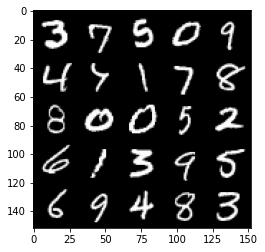

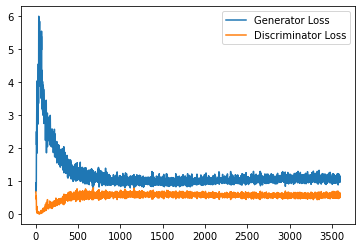

Step 72500: Generator loss: 1.0640254406929015, discriminator loss: 0.5740628198981285


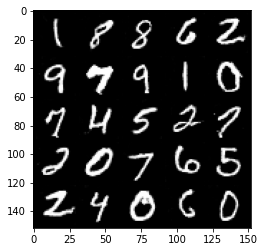

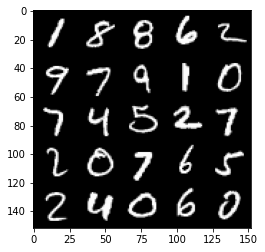

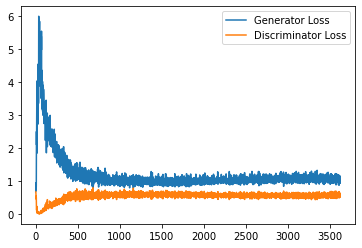

Step 73000: Generator loss: 1.0628473514318466, discriminator loss: 0.5760677134394646


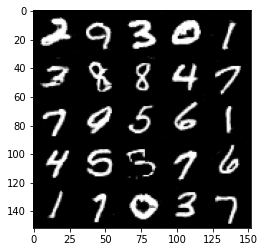

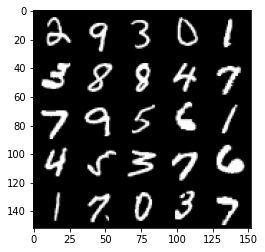

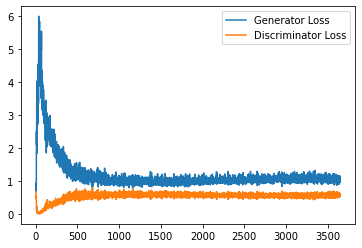

Step 73500: Generator loss: 1.0678510862588881, discriminator loss: 0.5770632731318474


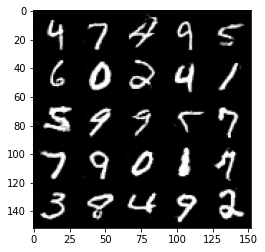

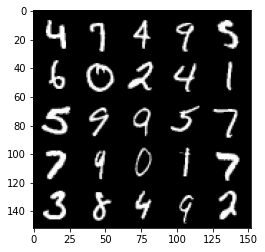

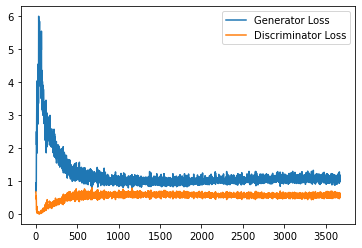

Step 74000: Generator loss: 1.0479144785404206, discriminator loss: 0.583534597158432


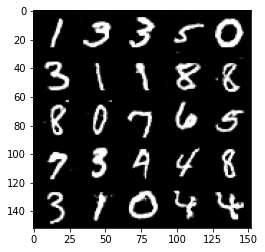

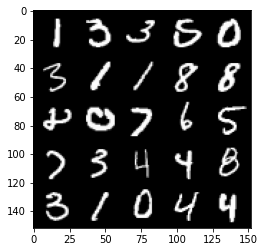

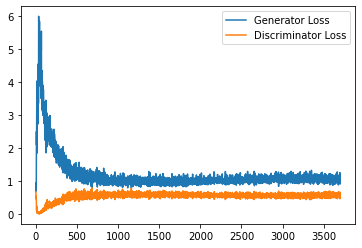

Step 74500: Generator loss: 1.0877196695804596, discriminator loss: 0.572494772017002


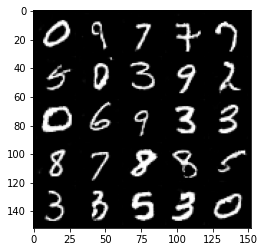

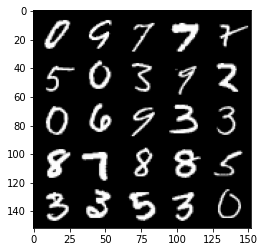

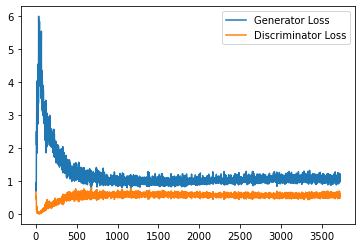

Step 75000: Generator loss: 1.054226355433464, discriminator loss: 0.5810156871676445


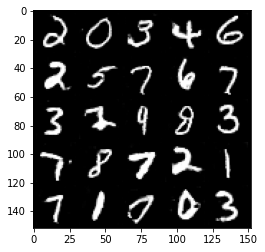

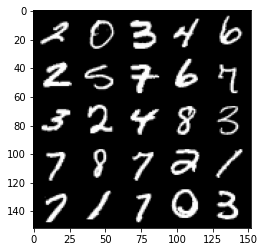

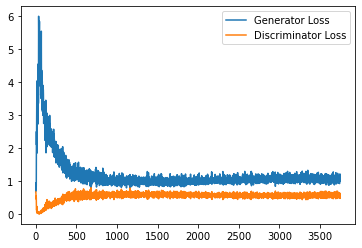

Step 75500: Generator loss: 1.0957933762073517, discriminator loss: 0.5753572374582291


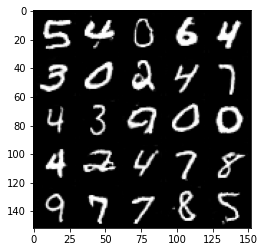

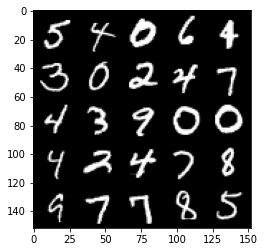

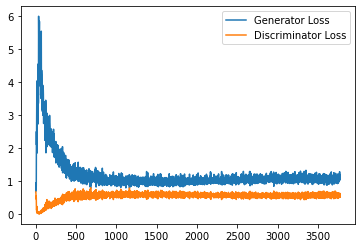

Step 76000: Generator loss: 1.0464257448911667, discriminator loss: 0.581422685444355


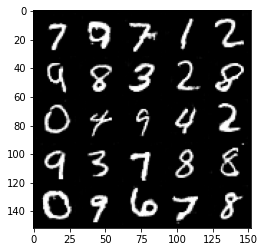

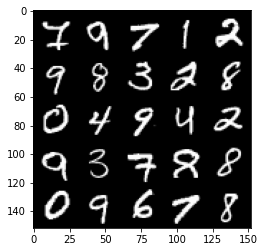

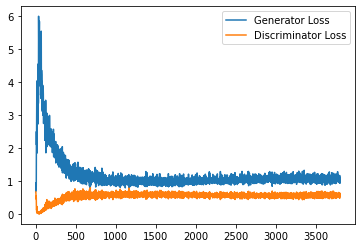

Step 76500: Generator loss: 1.0655688804388046, discriminator loss: 0.5810445473790169


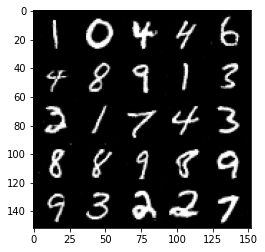

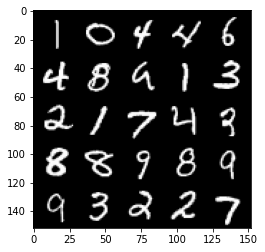

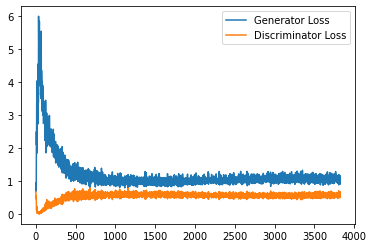

Step 77000: Generator loss: 1.0477599139213563, discriminator loss: 0.582336890757084


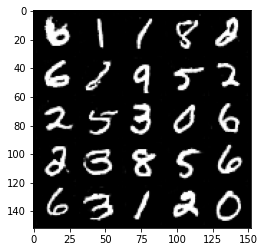

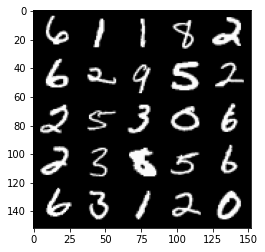

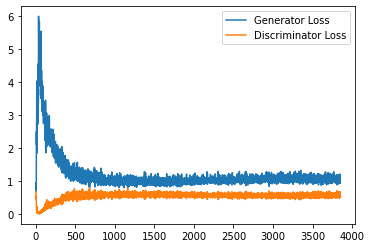

Step 77500: Generator loss: 1.0896537442207337, discriminator loss: 0.5741263653039932


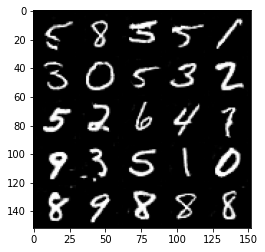

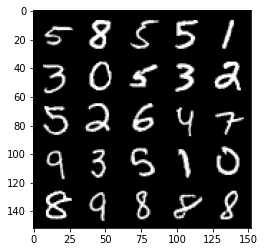

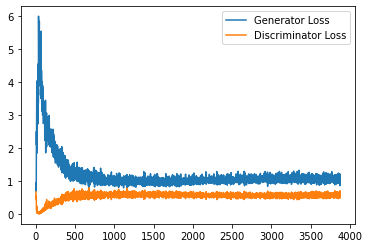

Step 78000: Generator loss: 1.0761323002576828, discriminator loss: 0.5796221761703492


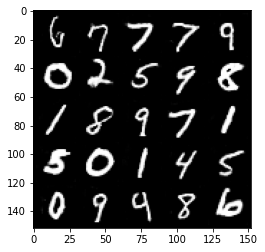

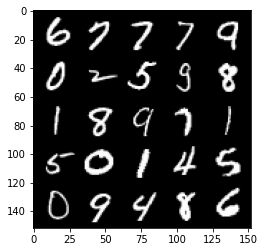

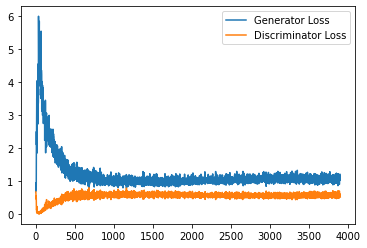

Step 78500: Generator loss: 1.0505531605482101, discriminator loss: 0.5899375700354577


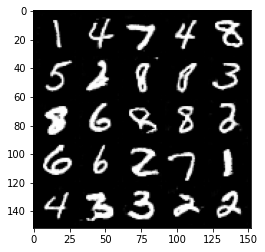

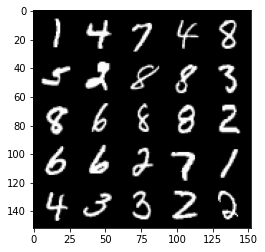

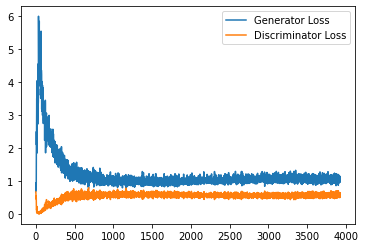

Step 79000: Generator loss: 1.059504327058792, discriminator loss: 0.5817034884095192


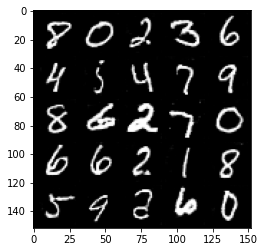

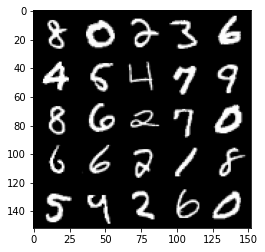

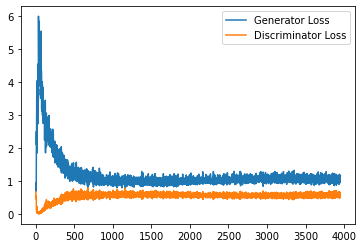

Step 79500: Generator loss: 1.0633808943033218, discriminator loss: 0.5832217987179756


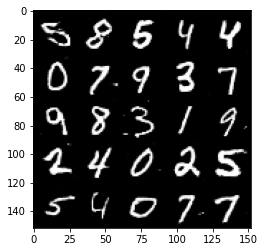

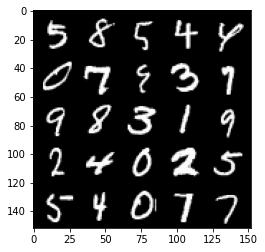

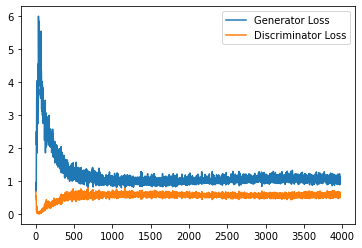

Step 80000: Generator loss: 1.046369058251381, discriminator loss: 0.5797986501455307


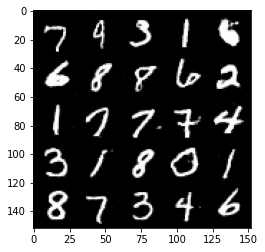

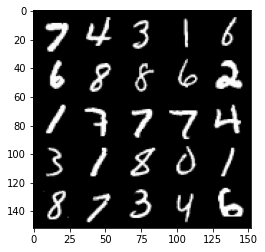

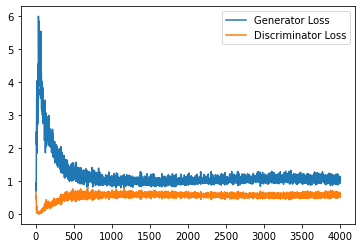

Step 80500: Generator loss: 1.0519472551345825, discriminator loss: 0.5849344184398652


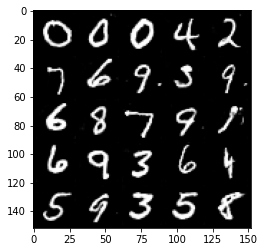

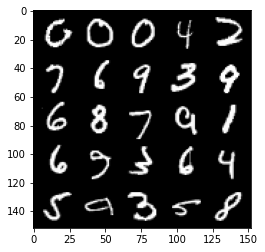

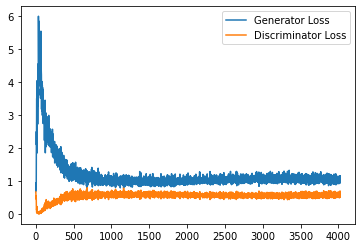

Step 81000: Generator loss: 1.0495884912014009, discriminator loss: 0.5787403566241265


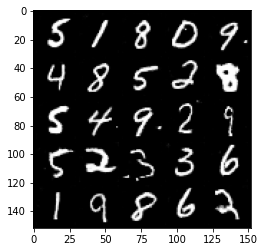

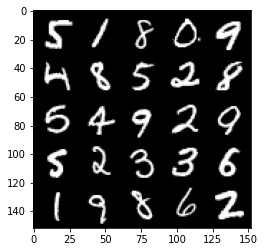

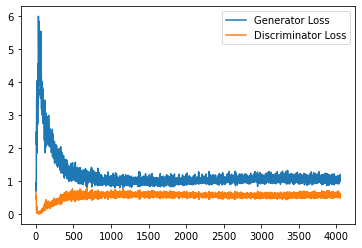

Step 81500: Generator loss: 1.053824755549431, discriminator loss: 0.5872419021129608


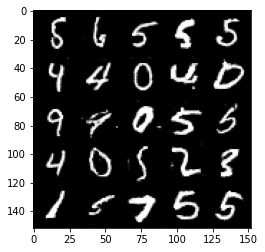

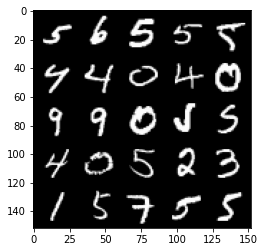

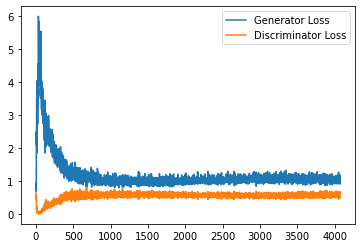

Step 82000: Generator loss: 1.0728024678230286, discriminator loss: 0.5861216341853142


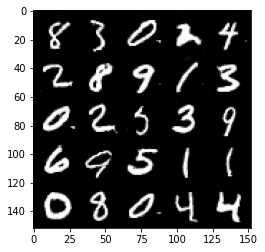

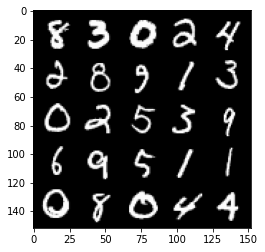

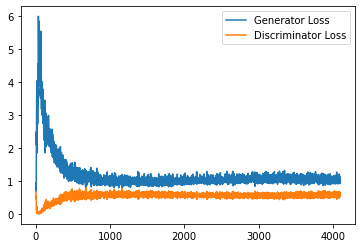

Step 82500: Generator loss: 1.0358014622926712, discriminator loss: 0.5818353071808815


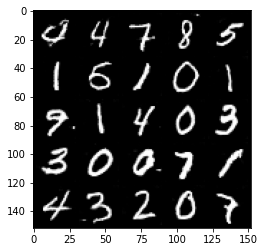

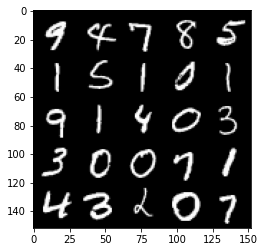

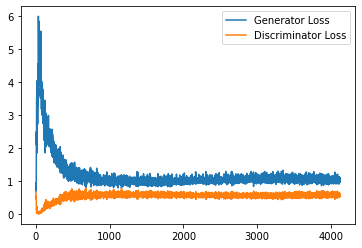

Step 83000: Generator loss: 1.0430540889501572, discriminator loss: 0.5890614197254181


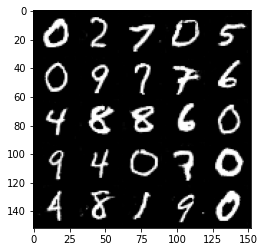

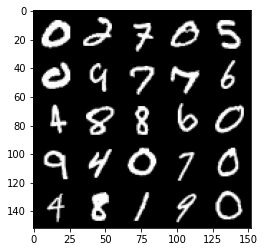

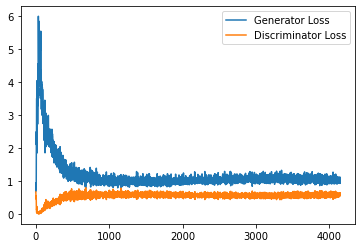

Step 83500: Generator loss: 1.0517365144491195, discriminator loss: 0.5867142927646637


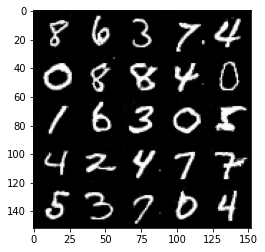

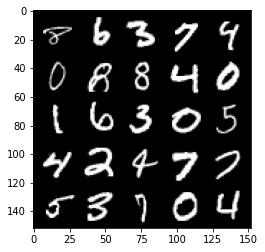

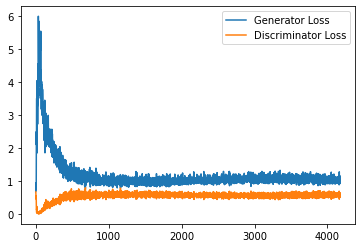

Step 84000: Generator loss: 1.0433986892700196, discriminator loss: 0.587538883626461


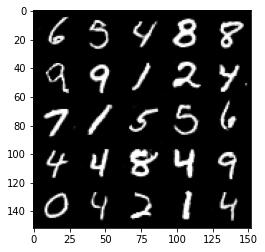

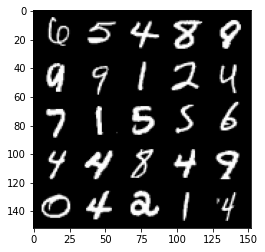

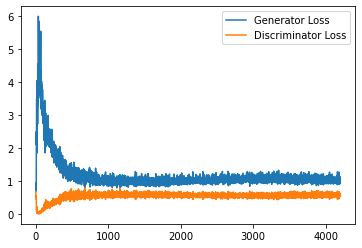

Step 84500: Generator loss: 1.0111355789899825, discriminator loss: 0.5902736764550209


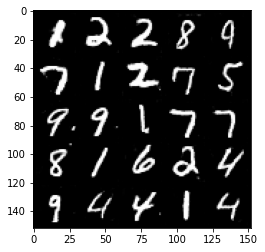

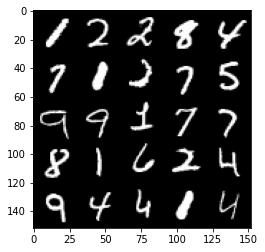

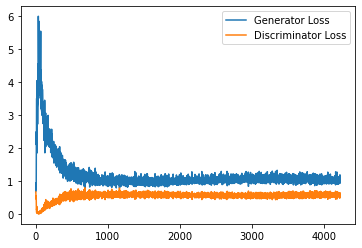

Step 85000: Generator loss: 1.0504984327554703, discriminator loss: 0.5946340909004212


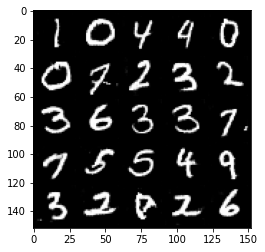

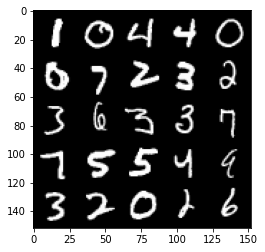

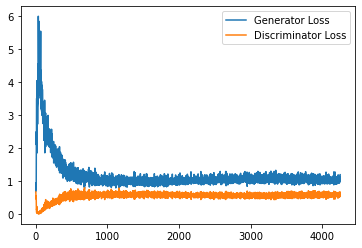

Step 85500: Generator loss: 1.0672190299034119, discriminator loss: 0.595942153275013


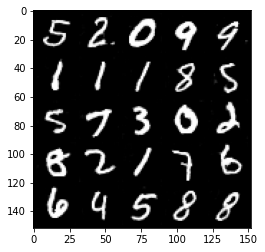

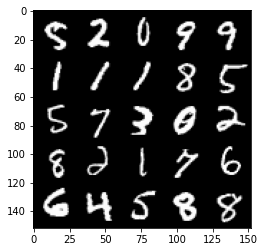

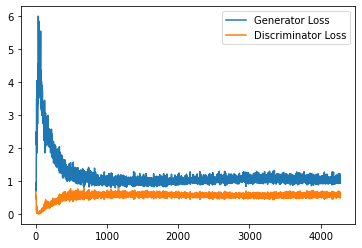

Step 86000: Generator loss: 1.044757748246193, discriminator loss: 0.5917812054753303


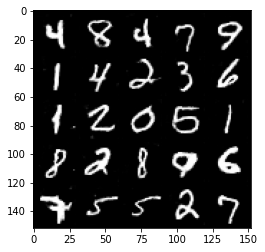

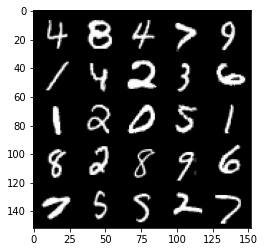

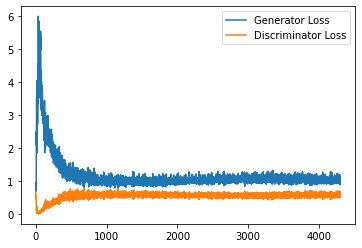

Step 86500: Generator loss: 1.0139867334365844, discriminator loss: 0.5893810346722603


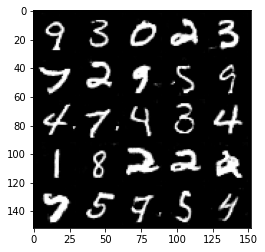

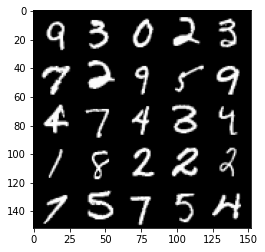

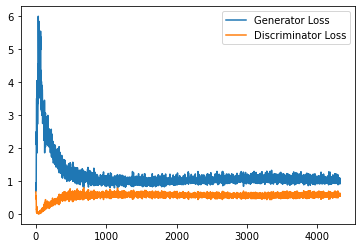

Step 87000: Generator loss: 1.0248771626949311, discriminator loss: 0.5969924502968789


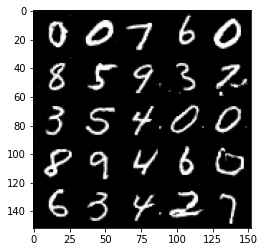

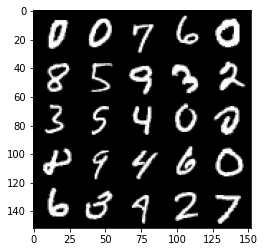

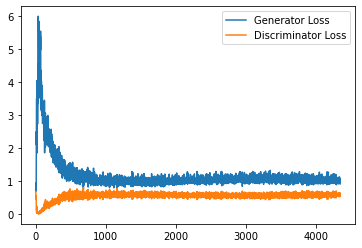

Step 87500: Generator loss: 1.0181461888551713, discriminator loss: 0.5933378729224205


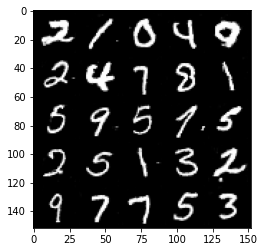

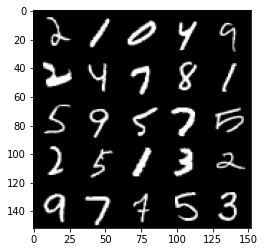

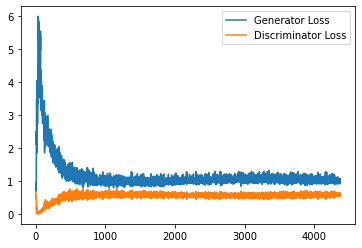

Step 88000: Generator loss: 1.061842539191246, discriminator loss: 0.5958629231452942


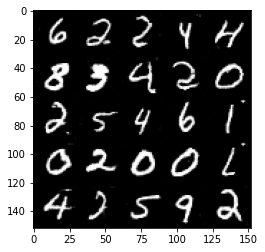

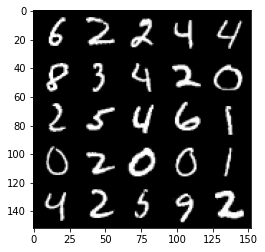

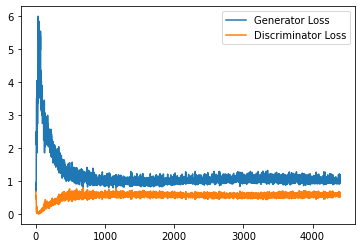

Step 88500: Generator loss: 1.0339172160625458, discriminator loss: 0.5949290180206299


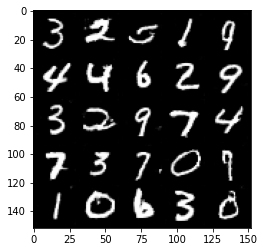

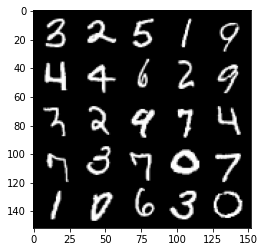

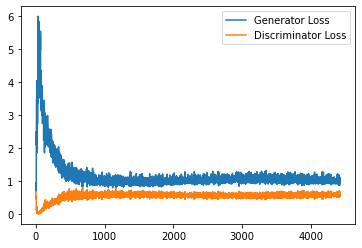

Step 89000: Generator loss: 1.0487113209962844, discriminator loss: 0.5964733412265778


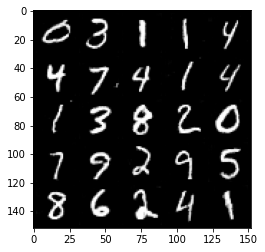

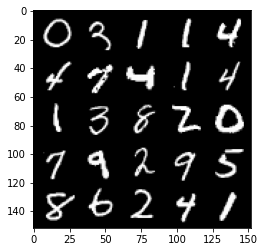

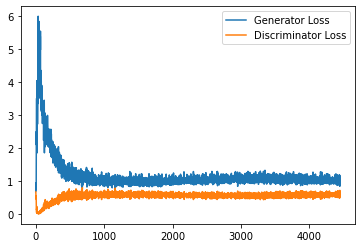

Step 89500: Generator loss: 1.0314070566892624, discriminator loss: 0.592918873846531


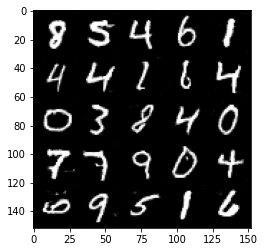

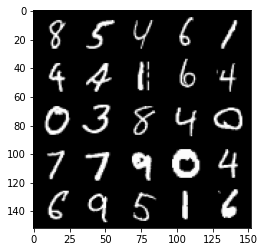

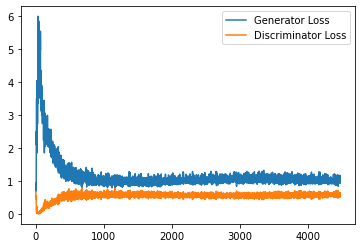

Step 90000: Generator loss: 1.0555511850118637, discriminator loss: 0.592947872042656


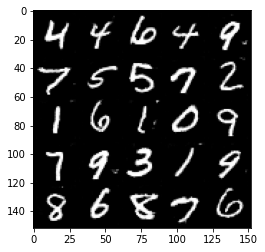

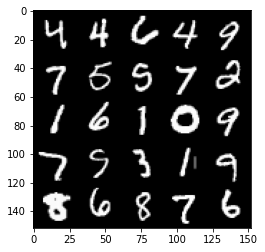

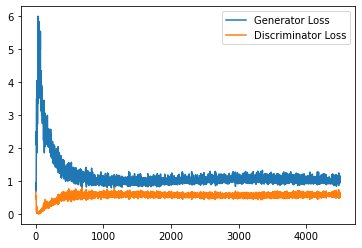

Step 90500: Generator loss: 1.0424081318378449, discriminator loss: 0.5955648939609528


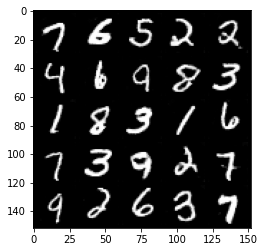

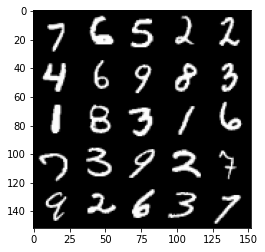

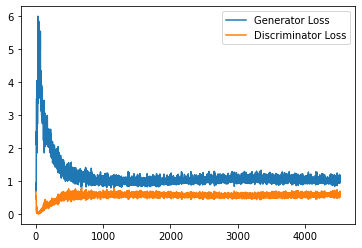

Step 91000: Generator loss: 1.0229095808267594, discriminator loss: 0.5967988979816437


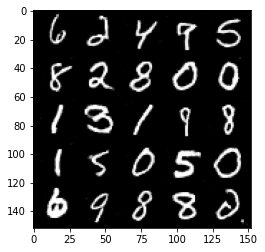

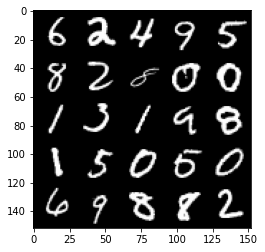

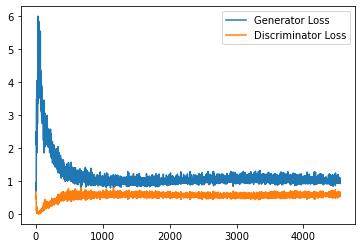

Step 91500: Generator loss: 1.0263758540153503, discriminator loss: 0.5911222004890442


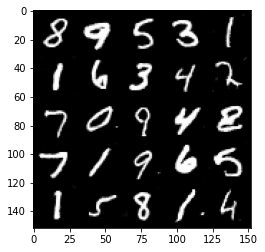

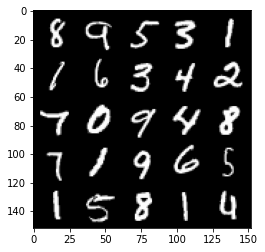

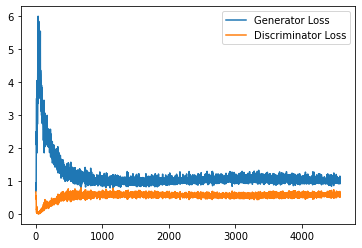

Step 92000: Generator loss: 1.0198153179883958, discriminator loss: 0.6004848747849464


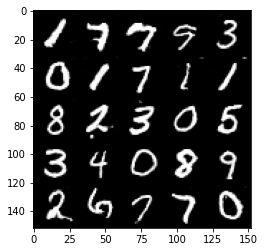

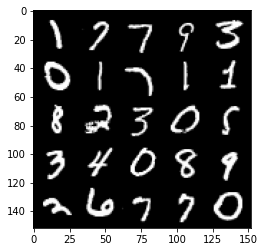

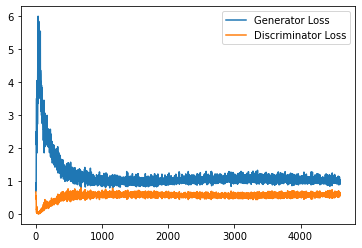

Step 92500: Generator loss: 1.0320224260091782, discriminator loss: 0.5975435627698898


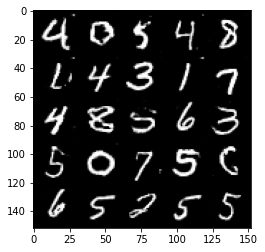

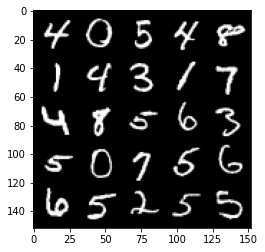

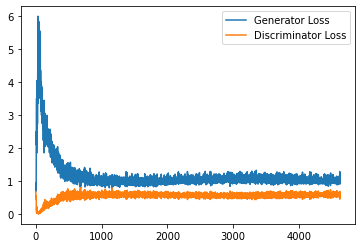

Step 93000: Generator loss: 1.0199975128173828, discriminator loss: 0.6003997139334679


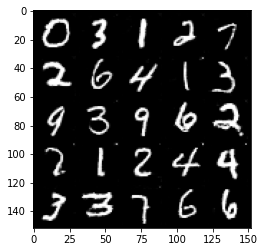

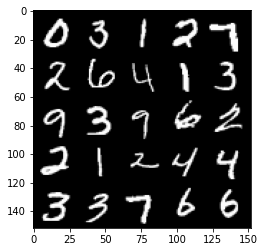

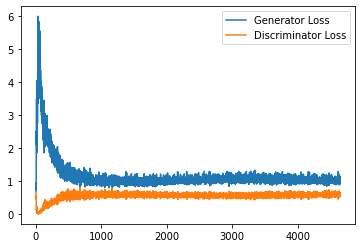

Step 93500: Generator loss: 1.033864790737629, discriminator loss: 0.5956905489563942


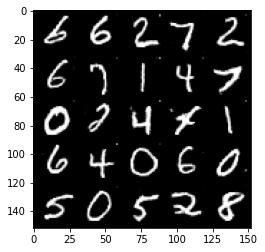

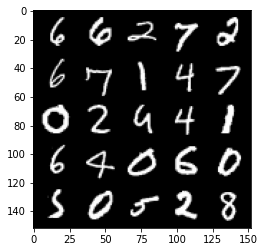

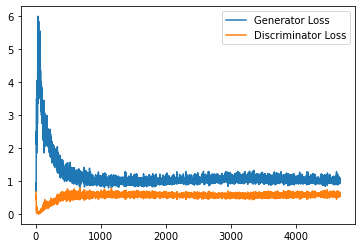

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

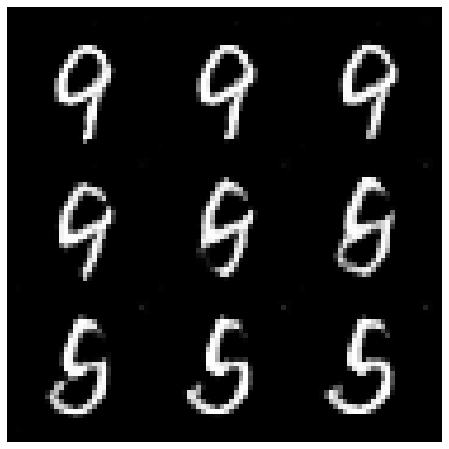

In [16]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 9 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

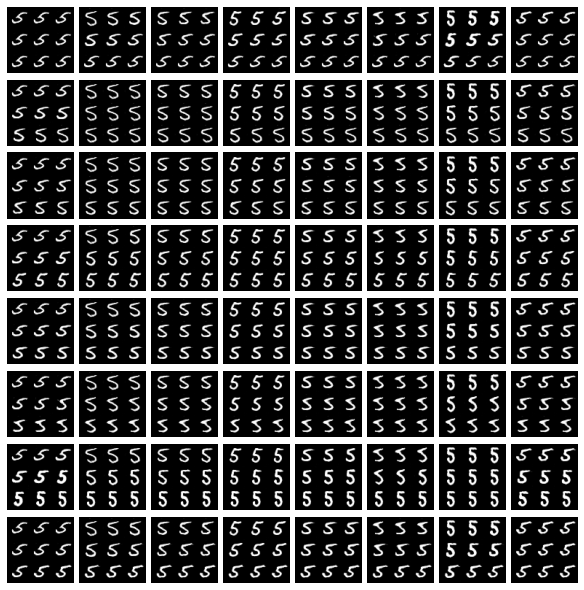

In [18]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 8 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()